<div style="background-color: #013a63; color: white; padding: 10px; border-square: 10px; text-align: center; font-size: 24px; font-weight: bold; max-width: 90%; margin: auto;">
    Final Project - Alzheimers Disease Prediction
</div>

### Project Overview

This project focuses on predicting the risk of Alzheimer's disease using supervised machine learning techniques. The primary task is a classification problem, where the objective is to determine whether an individual is likely to be diagnosed with Alzheimer's based on a variety of features.

We will employ several supervised learning algorithms, including Logistic Regression, Decision Trees, Random Forests, Gradient Boosting Machines (such as XGBoost, LightGBM, CatBoost), Support Vector Machines (SVM), and K-Nearest Neighbors (KNN). These models will be trained and evaluated to identify the most effective approach for this medical classification task.

By leveraging a comprehensive dataset containing demographic, lifestyle, medical, cognitive, and symptomatic information, the project aims to uncover key predictive factors and build robust models for Alzheimer's risk assessment. This work not only supports early identification and intervention strategies but also demonstrates the application of advanced supervised learning algorithms to a real-world healthcare problem.



<div style="background-color: magenta; color: white; padding: 10px; border-square: 10px; text-align: center; font-size: 24px; font-weight: bold; max-width: 90%; margin: auto;">
    Predictive, Exploratory and Analytical Questions
</div>

### Predictive Questions (Classification)

- **Risk Prediction:**
    - Can we predict the onset of Alzheimer's disease (binary outcome: Yes/No) using supervised machine learning models?

### Exploratory and Analytical Questions (Feature Importance/Correlation)

- **Key Risk Factors:**
    - Which demographic factors (age, gender, ethnicity, education level) are most strongly associated with Alzheimer's disease diagnosis?
    - How do lifestyle factors (BMI, smoking, alcohol consumption, physical activity, diet quality, sleep quality) individually or collectively influence Alzheimer's risk?
    - What medical history conditions (e.g., cardiovascular disease, diabetes, depression, hypertension) are most correlated with an Alzheimer's diagnosis?
    - Which clinical measurements (blood pressure, cholesterol levels) are significant predictors of Alzheimer's?
    - How do cognitive and functional assessment scores (MMSE, functional assessment, ADL) and specific symptoms (memory complaints, confusion, disorientation) relate to the diagnosis of Alzheimer's?
- **Interactions:**
    - Are there synergistic or antagonistic interactions between different risk factors that influence Alzheimer's development?
- **Data Quality:**
    - What is the extent of missing data, and how can it be effectively imputed or handled?
    - Are there outliers or inconsistencies in the data that need to be addressed?
- **Correlation Analysis:**
    - Which features are most strongly correlated with each other, and how might multicollinearity affect model performance?

For your Alzheimer's risk prediction project, which is a classification task, here are several supervised learning models you should explore. These models are commonly used for classification and offer different strengths:

1.  **Logistic Regression:**
    * **Why:** A fundamental and highly interpretable classification algorithm. It's a good baseline model and can help you understand the relationship between your features and the likelihood of Alzheimer's risk.
    * **Strengths:** Simple, fast, and provides probabilities.

2.  **Decision Trees:**
    * **Why:** Easy to understand and visualize, which can be useful for explaining how certain features lead to a prediction.
    * **Strengths:** Handles both numerical and categorical data, provides a clear decision path.

3.  **Random Forest:**
    * **Why:** An ensemble method that combines multiple decision trees. It generally offers higher accuracy and better generalization than a single decision tree. It's also robust to overfitting.
    * **Strengths:** High accuracy, handles large datasets with many features, less prone to overfitting than single trees.

4.  **Support Vector Machines (SVMs):**
    * **Why:** Effective in high-dimensional spaces and cases where the number of dimensions is greater than the number of samples. Can use different kernel functions to handle non-linear relationships.
    * **Strengths:** Good for complex classification tasks, effective in high-dimensional spaces.

5.  **Gradient Boosting Machines (e.g., XGBoost, LightGBM, CatBoost):**
    * **Why:** These are powerful ensemble techniques that build models sequentially, with each new model correcting errors made by previous ones. They often achieve state-of-the-art performance in tabular data competitions.
    * **Strengths:** High predictive accuracy, handles various data types well, robust to different data distributions.

6.  **K-Nearest Neighbors (KNN):**  
    * **Why:** KNN is a simple, non-parametric method that classifies a sample based on the majority class among its k nearest neighbors in the feature space. It can serve as a strong baseline and is useful for understanding local patterns in the data.  
    * **Strengths:** Easy to implement, no training phase, can capture non-linear decision boundaries, and works well with well-separated classes.  

7.  **Neural Networks (Deep Learning):**  
    * **Why:** Neural networks can model complex, non-linear relationships and interactions between features, which may be present in medical data. They are especially useful if you have a large dataset and want to capture subtle patterns that simpler models might miss.  
    * **Strengths:** Flexible, powerful for capturing complex feature interactions, can be extended to deep architectures for improved performance.  


For the models, need to consider:
* **Data preprocessing:** Each model might have different sensitivities to scaling, missing values, and categorical encoding.
* **Hyperparameter tuning:** Optimizing model parameters for your specific dataset.
* **Model evaluation:** Using appropriate metrics for classification (e.g., accuracy, precision, recall, F1-score, ROC-AUC), especially considering potential class imbalance if Alzheimer's cases are much less frequent than non-cases.

<div style="background-color: purple; color: white; padding: 10px; border-square: 10px; text-align: center; font-size: 24px; font-weight: bold; max-width: 90%; margin: auto;">
    Install Dependencies
</div>

In [80]:
#! pip3 install kagglehub
#!brew install libomp
#!pip3 install xgboost lightgbm catboost

<div style="background-color: purple; color: white; padding: 10px; border-square: 10px; text-align: center; font-size: 24px; font-weight: bold; max-width: 90%; margin: auto;">
    Libraries
</div>

In [81]:
import kagglehub
import os

import numpy as np
import pandas as pd

import matplotlib.pyplot as plt
import seaborn as sns

from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA

from sklearn.model_selection import train_test_split
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.ensemble import RandomForestRegressor
from sklearn.tree import DecisionTreeRegressor
from sklearn.svm import SVR
from sklearn.neighbors import KNeighborsRegressor
from sklearn.model_selection import GridSearchCV
from sklearn.metrics import accuracy_score, confusion_matrix, classification_report, roc_curve, roc_auc_score

from sklearn.neural_network import MLPClassifier
from sklearn.model_selection import GridSearchCV
from sklearn.neighbors import KNeighborsClassifier
from sklearn.svm import SVC
from xgboost import XGBClassifier
from lightgbm import LGBMClassifier
from catboost import CatBoostClassifier

from sklearn.model_selection import GridSearchCV
from sklearn.ensemble import GradientBoostingClassifier
import plotly.graph_objects as go


<div style="background-color: purple; color: white; padding: 10px; border-square: 10px; text-align: center; font-size: 24px; font-weight: bold; max-width: 90%; margin: auto;">
    Alzheimer's Disease Dataset
</div>

### About Dataset

This dataset contains extensive health information for 2,149 patients, each uniquely identified with IDs ranging from 4751 to 6900. The dataset includes demographic details, lifestyle factors, medical history, clinical measurements, cognitive and functional assessments, symptoms, and a diagnosis of Alzheimer's Disease. The data is ideal for researchers and data scientists looking to explore factors associated with Alzheimer's, develop predictive models, and conduct statistical analyses.



### Table of Contents

* [Patient Information](#patient-information)
    * [Patient ID](#patient-id)
* [Demographic Details](#demographic-details)
* [Lifestyle Factors](#lifestyle-factors)
* [Medical History](#medical-history)
* [Clinical Measurements](#clinical-measurements)
* [Cognitive and Functional Assessments](#cognitive-and-functional-assessments)
* [Symptoms](#symptoms)
* [Diagnosis Information](#diagnosis-information)
* [Confidential Information](#confidential-information)

---

### Patient Information

### Patient ID

* **PatientID**: A unique identifier assigned to each patient (4751 to 6900).

### Demographic Details

* **Age**: The age of the patients ranges from 60 to 90 years.
* **Gender**: Gender of the patients, where `0` represents Male and `1` represents Female.
* **Ethnicity**: The ethnicity of the patients, coded as follows:
    * `0`: Caucasian
    * `1`: African American
    * `2`: Asian
    * `3`: Other
* **EducationLevel**: The education level of the patients, coded as follows:
    * `0`: None
    * `1`: High School
    * `2`: Bachelor's
    * `3`: Higher

### Lifestyle Factors

* **BMI**: Body Mass Index of the patients, ranging from 15 to 40.
* **Smoking**: Smoking status, where `0` indicates No and `1` indicates Yes.
* **AlcoholConsumption**: Weekly alcohol consumption in units, ranging from 0 to 20.
* **PhysicalActivity**: Weekly physical activity in hours, ranging from 0 to 10.
* **DietQuality**: Diet quality score, ranging from 0 to 10.
* **SleepQuality**: Sleep quality score, ranging from 4 to 10.

### Medical History

* **FamilyHistoryAlzheimers**: Family history of Alzheimer's Disease, where `0` indicates No and `1` indicates Yes.
* **CardiovascularDisease**: Presence of cardiovascular disease, where `0` indicates No and `1` indicates Yes.
* **Diabetes**: Presence of diabetes, where `0` indicates No and `1` indicates Yes.
* **Depression**: Presence of depression, where `0` indicates No and `1` indicates Yes.
* **HeadInjury**: History of head injury, where `0` indicates No and `1` indicates Yes.
* **Hypertension**: Presence of hypertension, where `0` indicates No and `1` indicates Yes.

### Clinical Measurements

* **SystolicBP**: Systolic blood pressure, ranging from 90 to 180 mmHg.
* **DiastolicBP**: Diastolic blood pressure, ranging from 60 to 120 mmHg.
* **CholesterolTotal**: Total cholesterol levels, ranging from 150 to 300 mg/dL.
* **CholesterolLDL**: Low-density lipoprotein cholesterol levels, ranging from 50 to 200 mg/dL.
* **CholesterolHDL**: High-density lipoprotein cholesterol levels, ranging from 20 to 100 mg/dL.
* **CholesterolTriglycerides**: Triglycerides levels, ranging from 50 to 400 mg/dL.

### Cognitive and Functional Assessments

* **MMSE**: Mini-Mental State Examination score, ranging from 0 to 30. Lower scores indicate cognitive impairment.
* **FunctionalAssessment**: Functional assessment score, ranging from 0 to 10. Lower scores indicate greater impairment.
* **MemoryComplaints**: Presence of memory complaints, where `0` indicates No and `1` indicates Yes.
* **BehavioralProblems**: Presence of behavioral problems, where `0` indicates No and `1` indicates Yes.
* **ADL**: Activities of Daily Living score, ranging from 0 to 10. Lower scores indicate greater impairment.

### Symptoms

* **Confusion**: Presence of confusion, where `0` indicates No and `1` indicates Yes.
* **Disorientation**: Presence of disorientation, where `0` indicates No and `1` indicates Yes.
* **PersonalityChanges**: Presence of personality changes, where `0` indicates No and `1` indicates Yes.
* **DifficultyCompletingTasks**: Presence of difficulty completing tasks, where `0` indicates No and `1` indicates Yes.
* **Forgetfulness**: Presence of forgetfulness, where `0` indicates No and `1` indicates Yes.

### Diagnosis Information

* **Diagnosis**: Diagnosis status for Alzheimer's Disease, where `0` indicates No and `1` indicates Yes.

### Confidential Information

* **DoctorInCharge**: This column contains confidential information about the doctor in charge, with "XXXConfid" as the value for all patients.

---

### Conclusion

This dataset offers extensive insights into the factors associated with Alzheimer's Disease, including demographic, lifestyle, medical, cognitive, and functional variables. It is ideal for developing predictive models, conducting statistical analyses, and exploring the complex interplay of factors contributing to Alzheimer's Disease.

### Citation

### Dataset Usage and Attribution Notice

This dataset, shared by Rabie El Kharoua, is original and has never been shared before. It is made available under the [CC BY 4.0 license](https://creativecommons.org/licenses/by/4.0/), allowing anyone to use the dataset in any form as long as proper citation is given to the author. A DOI is provided for proper referencing. Please note that duplication of this work within Kaggle is not permitted.

### Exclusive Synthetic Dataset

This dataset is synthetic and was generated for educational purposes, making it ideal for data science and machine learning projects. It is an original dataset, owned by Mr. Rabie El Kharoua, and has not been previously shared. You are free to use it under the license outlined on the data card. The dataset is offered without any guarantees. Details about the data provider will be shared soon.

#### Source

Dataset Author: Rabie El Kharoua  
Kaggle Dataset Link: [Alzheimer's Disease Risk Prediction Dataset](https://www.kaggle.com/datasets/rabieelkharoua/alzheimers-disease-risk-prediction)








<div style="background-color: purple; color: white; padding: 10px; border-square: 10px; text-align: center; font-size: 24px; font-weight: bold; max-width: 90%; margin: auto;">
    Loading the Dataset and Inspection
</div>

### Loading Data

In [82]:
# Download the dataset using kagglehub
path = kagglehub.dataset_download("rabieelkharoua/alzheimers-disease-dataset")

print("Path to dataset files:", path)

# Load the CSV file into a DataFrame
df = pd.read_csv(os.path.join(path, "alzheimers_disease_data.csv"))

# Display the first few rows of the DataFrame
df.head().T

Path to dataset files: C:\Users\Afiat_Trading\.cache\kagglehub\datasets\rabieelkharoua\alzheimers-disease-dataset\versions\1


,0,1,2,3,4
PatientID,4751,4752,4753,4754,4755
Age,73,89,73,74,89
Gender,0,0,0,1,0
Ethnicity,0,0,3,0,0
EducationLevel,2,0,1,1,0
BMI,22.927749,26.827681,17.795882,33.800817,20.716974
Smoking,0,0,0,1,0
AlcoholConsumption,13.297218,4.542524,19.555085,12.209266,18.454356
PhysicalActivity,6.327112,7.619885,7.844988,8.428001,6.310461
DietQuality,1.347214,0.518767,1.826335,7.435604,0.795498


### Data Types

In [83]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 2149 entries, 0 to 2148
Data columns (total 35 columns):
 #   Column                     Non-Null Count  Dtype  
---  ------                     --------------  -----  
 0   PatientID                  2149 non-null   int64  
 1   Age                        2149 non-null   int64  
 2   Gender                     2149 non-null   int64  
 3   Ethnicity                  2149 non-null   int64  
 4   EducationLevel             2149 non-null   int64  
 5   BMI                        2149 non-null   float64
 6   Smoking                    2149 non-null   int64  
 7   AlcoholConsumption         2149 non-null   float64
 8   PhysicalActivity           2149 non-null   float64
 9   DietQuality                2149 non-null   float64
 10  SleepQuality               2149 non-null   float64
 11  FamilyHistoryAlzheimers    2149 non-null   int64  
 12  CardiovascularDisease      2149 non-null   int64  
 13  Diabetes                   2149 non-null   int64

### Describe Dataset

In [84]:
df.describe().T

,count,mean,std,min,25%,50%,75%,max
PatientID,2149.0,5825.000000,620.507185,4751.000000,5288.000000,5825.000000,6362.000000,6899.000000
Age,2149.0,74.908795,8.990221,60.000000,67.000000,75.000000,83.000000,90.000000
Gender,2149.0,0.506282,0.500077,0.000000,0.000000,1.000000,1.000000,1.000000
Ethnicity,2149.0,0.697534,0.996128,0.000000,0.000000,0.000000,1.000000,3.000000
EducationLevel,2149.0,1.286645,0.904527,0.000000,1.000000,1.000000,2.000000,3.000000
BMI,2149.0,27.655697,7.217438,15.008851,21.611408,27.823924,33.869778,39.992767
Smoking,2149.0,0.288506,0.453173,0.000000,0.000000,0.000000,1.000000,1.000000
AlcoholConsumption,2149.0,10.039442,5.757910,0.002003,5.139810,9.934412,15.157931,19.989293
PhysicalActivity,2149.0,4.920202,2.857191,0.003616,2.570626,4.766424,7.427899,9.987429
DietQuality,2149.0,4.993138,2.909055,0.009385,2.458455,5.076087,7.558625,9.998346


<div style="background-color: purple; color: white; padding: 10px; border-square: 10px; text-align: center; font-size: 24px; font-weight: bold; max-width: 90%; margin: auto;">
    Data Cleaning and Exploratory Data Analysis (EDA)
</div>

### Look for NaN/Null and Duplicate Data

In [85]:
df.isna().any().any()

False

In [86]:
df.duplicated().any()

False

### Features to be dropped

Based on the data and the full dataset description, drop the following:

1.  **`DoctorInCharge` Column:**
    * **Reason:** As explicitly stated in your dataset description and shown in your sample (`XXXConfid` for all entries), this column contains confidential, non-informative data that is identical for all patients. It will not contribute to your predictive model and should be dropped.

2.  **`PatientID` Column:**
    * **Reason:** This is a unique identifier for each patient and does not contain predictive information. Including it could introduce noise or data leakage into the model, so it should be removed before modeling.

In [87]:
# Drop 'DoctorInCharge' and 'PatientID' columns as they are non-informative for prediction
df = df.drop(columns=['DoctorInCharge', 'PatientID'])

# Display the first few rows of the DataFrame
df.head().T

,0,1,2,3,4
Age,73.000000,89.000000,73.000000,74.000000,89.000000
Gender,0.000000,0.000000,0.000000,1.000000,0.000000
Ethnicity,0.000000,0.000000,3.000000,0.000000,0.000000
EducationLevel,2.000000,0.000000,1.000000,1.000000,0.000000
BMI,22.927749,26.827681,17.795882,33.800817,20.716974
Smoking,0.000000,0.000000,0.000000,1.000000,0.000000
AlcoholConsumption,13.297218,4.542524,19.555085,12.209266,18.454356
PhysicalActivity,6.327112,7.619885,7.844988,8.428001,6.310461
DietQuality,1.347214,0.518767,1.826335,7.435604,0.795498
SleepQuality,9.025679,7.151293,9.673574,8.392554,5.597238


In [88]:
print("Features in the dataset (excluding target 'Diagnosis'):")
print(list(df.drop(columns=['Diagnosis']).columns))

Features in the dataset (excluding target 'Diagnosis'):
['Age', 'Gender', 'Ethnicity', 'EducationLevel', 'BMI', 'Smoking', 'AlcoholConsumption', 'PhysicalActivity', 'DietQuality', 'SleepQuality', 'FamilyHistoryAlzheimers', 'CardiovascularDisease', 'Diabetes', 'Depression', 'HeadInjury', 'Hypertension', 'SystolicBP', 'DiastolicBP', 'CholesterolTotal', 'CholesterolLDL', 'CholesterolHDL', 'CholesterolTriglycerides', 'MMSE', 'FunctionalAssessment', 'MemoryComplaints', 'BehavioralProblems', 'ADL', 'Confusion', 'Disorientation', 'PersonalityChanges', 'DifficultyCompletingTasks', 'Forgetfulness']


#### Scaling the data

In [89]:
# Standardize the dataframe (excluding the target 'Diagnosis')
#scaler = StandardScaler()
#df_scaled = df.copy()
#feature_cols = df.columns.drop('Diagnosis')
#df_scaled[feature_cols] = scaler.fit_transform(df[feature_cols])

# Display the first few rows of the scaled dataframe
#df_scaled.head()

### Dimensionality Reduction

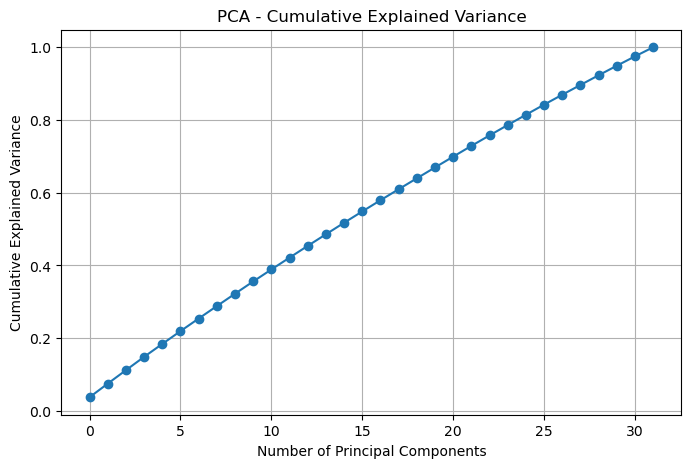

,Principal Component,Explained Variance Ratio
0,PC1,0.037824
1,PC2,0.037427
2,PC3,0.036925
3,PC4,0.036666
4,PC5,0.035525
5,PC6,0.035174
6,PC7,0.034604
7,PC8,0.034266
8,PC9,0.033986
9,PC10,0.033710


In [90]:
# Select only numeric features for PCA (excluding the target 'Diagnosis')
features = df.drop(columns=['Diagnosis'])
feature_names = features.columns

# Standardize the features
scaler = StandardScaler()
X_scaled = scaler.fit_transform(features)

# Perform PCA
pca = PCA()
X_pca = pca.fit_transform(X_scaled)

# Explained variance ratio plot
plt.figure(figsize=(8, 5))
plt.plot(np.cumsum(pca.explained_variance_ratio_), marker='o')
plt.xlabel('Number of Principal Components')
plt.ylabel('Cumulative Explained Variance')
plt.title('PCA - Cumulative Explained Variance')
plt.grid(True)
plt.show()

# Display explained variance for each component
explained_variance = pd.DataFrame({
    'Principal Component': [f'PC{i+1}' for i in range(len(pca.explained_variance_ratio_))],
    'Explained Variance Ratio': pca.explained_variance_ratio_
})
explained_variance.head(32)

### Why Features Were Not Removed Based on PCA

Although Principal Component Analysis (PCA) was performed to explore the variance explained by combinations of features, we did **not** remove features solely based on PCA results. The main reasons are:

- **Interpretability:** Removing features based on PCA would replace original variables with principal components, making it difficult to interpret which specific factors contribute to Alzheimer's risk.
- **Supervised Learning Context:** PCA is an unsupervised technique and does not consider the relationship between features and the target variable (Diagnosis). Important predictors for classification might not align with the top principal components.
- **Feature Importance:** Tree-based and linear models provide direct measures of feature importance, allowing us to identify and retain the most predictive features in a supervised manner.
- **Preserving Domain Knowledge:** Retaining original features ensures that domain knowledge and clinical relevance are maintained, which is crucial for healthcare applications.

Therefore, PCA was used for exploratory analysis and visualization, not for feature elimination in the predictive modeling workflow.

### Correlation Matrix

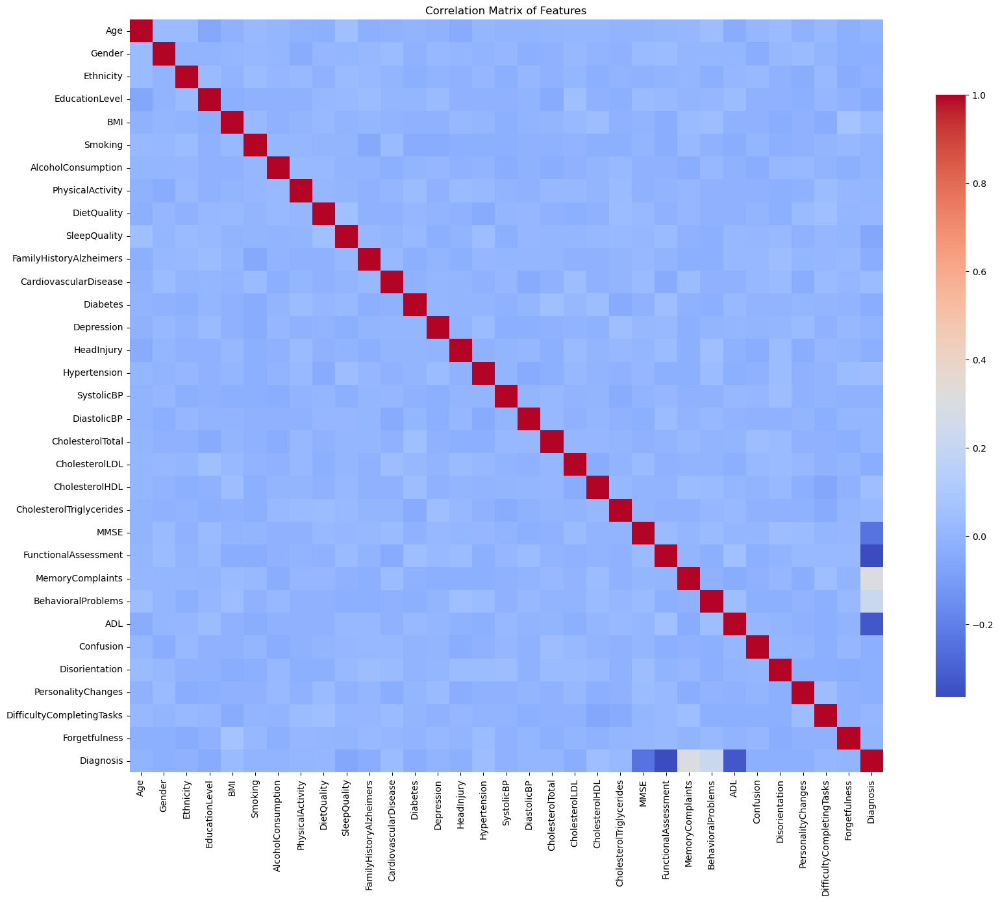

In [91]:
# Compute and plot the correlation matrix for all numeric features
plt.figure(figsize=(18, 14))
corr = df.corr()
sns.heatmap(corr, annot=False, cmap='coolwarm', square=True, cbar_kws={"shrink": .8})
plt.title('Correlation Matrix of Features')
plt.tight_layout()
plt.show()

In [92]:
# Print the correlation matrix as a table
corr_table = corr.round(3)
display(corr_table)

# Print the top 5 feature pairs with highest absolute correlation (excluding self-correlation)
corr_pairs = corr.abs().unstack()
corr_pairs = corr_pairs[corr_pairs.index.get_level_values(0) != corr_pairs.index.get_level_values(1)]
top5_pairs = corr_pairs.sort_values(ascending=False).drop_duplicates().head(5)
print("Top 5 correlated feature pairs (absolute value):")
for (f1, f2), val in top5_pairs.items():
    print(f"{f1} & {f2}: {corr.loc[f1, f2]:.3f}")

,Age,Gender,Ethnicity,EducationLevel,BMI,Smoking,AlcoholConsumption,PhysicalActivity,DietQuality,SleepQuality,...,FunctionalAssessment,MemoryComplaints,BehavioralProblems,ADL,Confusion,Disorientation,PersonalityChanges,DifficultyCompletingTasks,Forgetfulness,Diagnosis
Age,1.000,0.029,0.028,-0.061,-0.016,0.020,0.007,-0.010,-0.023,0.049,...,0.006,0.012,0.039,-0.039,0.009,0.028,-0.009,0.014,-0.019,-0.005
Gender,0.029,1.000,-0.004,-0.007,0.006,0.017,0.004,-0.036,0.011,0.007,...,0.033,0.004,0.006,0.004,-0.031,0.018,0.026,-0.002,-0.029,-0.021
Ethnicity,0.028,-0.004,1.000,0.027,-0.003,0.031,0.008,0.020,-0.018,0.029,...,-0.005,0.004,-0.019,0.010,0.022,-0.018,-0.030,0.019,-0.035,-0.015
EducationLevel,-0.061,-0.007,0.027,1.000,-0.024,-0.010,-0.013,-0.017,0.017,0.020,...,0.020,-0.000,0.010,0.032,-0.008,-0.018,-0.020,0.013,-0.009,-0.044
BMI,-0.016,0.006,-0.003,-0.024,1.000,0.020,-0.009,0.001,0.020,-0.006,...,-0.031,0.029,0.035,-0.010,-0.016,-0.032,-0.016,-0.039,0.071,0.026
Smoking,0.020,0.017,0.031,-0.010,0.020,1.000,0.008,0.011,-0.002,-0.001,...,-0.032,0.020,-0.015,-0.029,0.004,-0.028,-0.010,0.002,0.018,-0.005
AlcoholConsumption,0.007,0.004,0.008,-0.013,-0.009,0.008,1.000,0.022,0.020,-0.004,...,-0.016,-0.029,0.014,-0.008,-0.033,0.016,0.019,-0.003,-0.024,-0.008
PhysicalActivity,-0.010,-0.036,0.020,-0.017,0.001,0.011,0.022,1.000,0.011,-0.002,...,-0.002,0.009,-0.014,-0.013,-0.009,-0.020,-0.014,0.031,0.010,0.006
DietQuality,-0.023,0.011,-0.018,0.017,0.020,-0.002,0.020,0.011,1.000,0.051,...,-0.010,0.013,-0.014,-0.008,0.003,-0.026,0.029,0.046,0.006,0.009
SleepQuality,0.049,0.007,0.029,0.020,-0.006,-0.001,-0.004,-0.002,0.051,1.000,...,0.030,-0.017,-0.020,0.015,0.014,0.019,-0.017,0.011,0.003,-0.057


Top 5 correlated feature pairs (absolute value):
Diagnosis & FunctionalAssessment: -0.365
Diagnosis & ADL: -0.332
MemoryComplaints & Diagnosis: 0.307
Diagnosis & MMSE: -0.237
BehavioralProblems & Diagnosis: 0.224


### Summary of Correlation Analysis

The correlation analysis revealed that most relationships among features in the Alzheimer's Disease dataset were weak to moderate, with the majority of correlation coefficients below 0.35:

- **Weak to Moderate Correlations:** Most feature pairs, including cognitive and functional assessment scores (MMSE, FunctionalAssessment, ADL), showed only moderate correlations, indicating some association but not strong redundancy.
- **Medical History Associations:** Features related to medical history (e.g., CardiovascularDisease, Diabetes, Hypertension) exhibited low to moderate correlations, suggesting some clustering of comorbid conditions.
- **Lifestyle and Clinical Measures:** Lifestyle factors (BMI, PhysicalActivity, DietQuality) and clinical measurements (blood pressure, cholesterol levels) were also only weakly to moderately correlated.
- **Diagnosis Correlation:** The target variable (Diagnosis) had its highest correlations with cognitive scores, age, and family history of Alzheimer's, but these were still moderate rather than strong.
- **No Severe Multicollinearity:** No feature pairs exhibited very high correlation (close to 1), indicating that multicollinearity is not a major concern for most models.

Overall, the correlation matrix suggests that while certain features are related, there is no severe redundancy, and each feature may contribute unique information for Alzheimer's disease prediction.

### Pairplot 

In [93]:
sns.pairplot(df, hue='Diagnosis', palette='Set1')
#plt.savefig('pair_plot.png', dpi=300, bbox_inches='tight')
plt.show()


### Inspect the Dataset

### Age Distribution

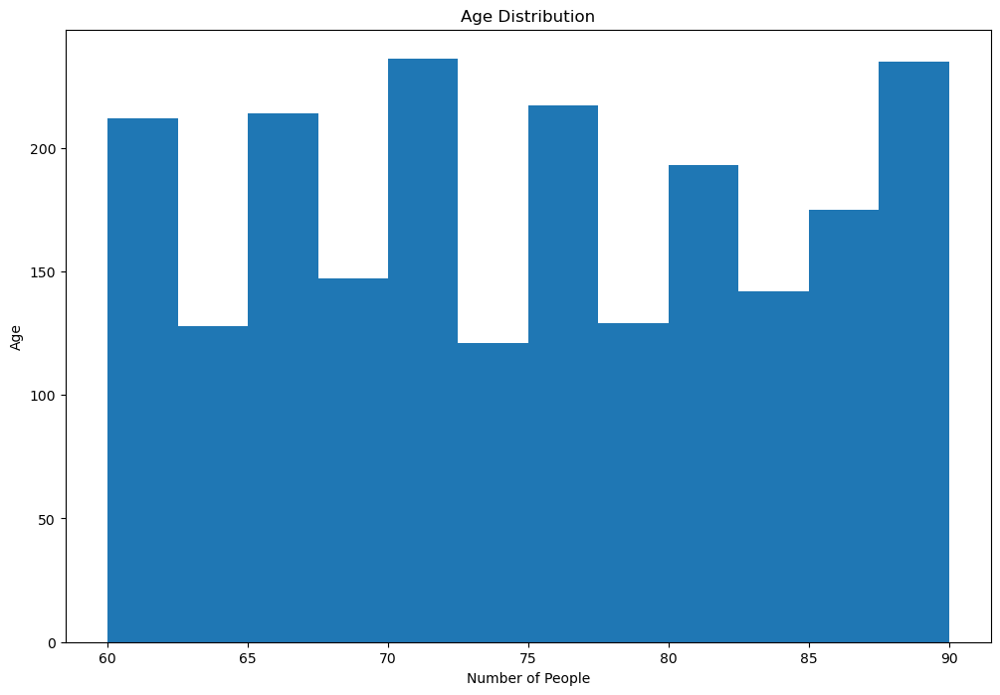

In [94]:
plt.figure(figsize=(12,8))
plt.hist(df['Age'], bins=12)
plt.title("Age Distribution")
plt.xlabel("Number of People")
plt.ylabel("Age")
plt.show()

### Gender Distribution

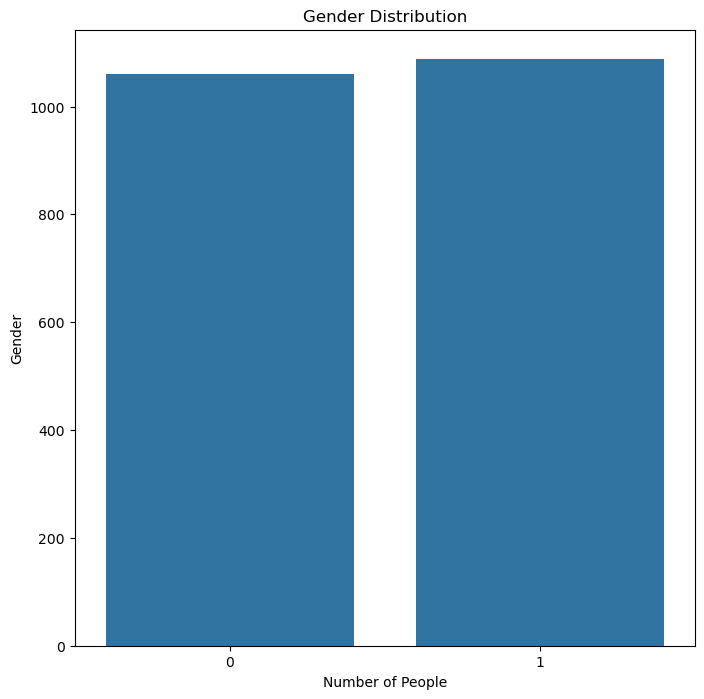

In [95]:
plt.figure(figsize=(8,8))
sns.countplot(x='Gender',data=df)
plt.title("Gender Distribution")
plt.xlabel("Number of People")
plt.ylabel("Gender")
plt.show()

### Diagnosis Status

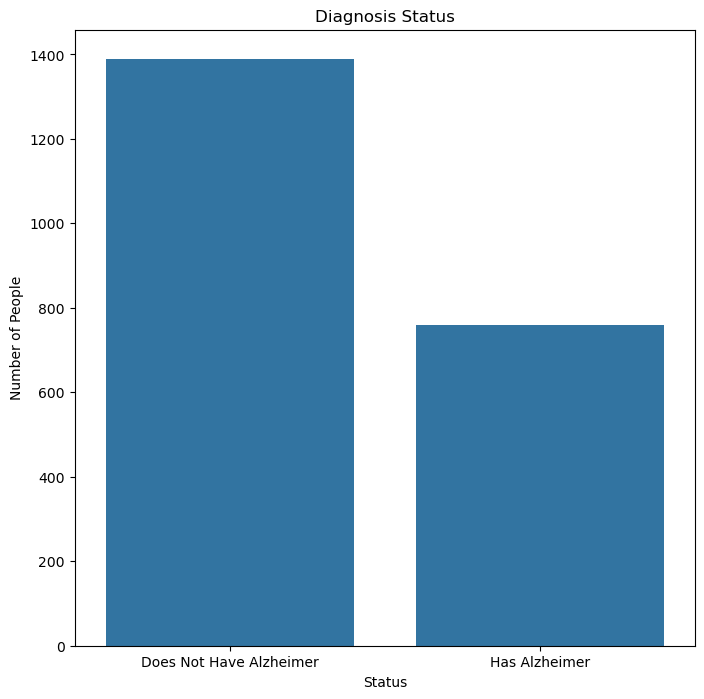

In [96]:
plt.figure(figsize=(8,8))
sns.countplot(x='Diagnosis', data=df)
plt.title("Diagnosis Status")
plt.xlabel("Status")
plt.ylabel("Number of People")
plt.xticks([0, 1], ['Does Not Have Alzheimer', 'Has Alzheimer'])
plt.show()

### Ethnicity Distribution

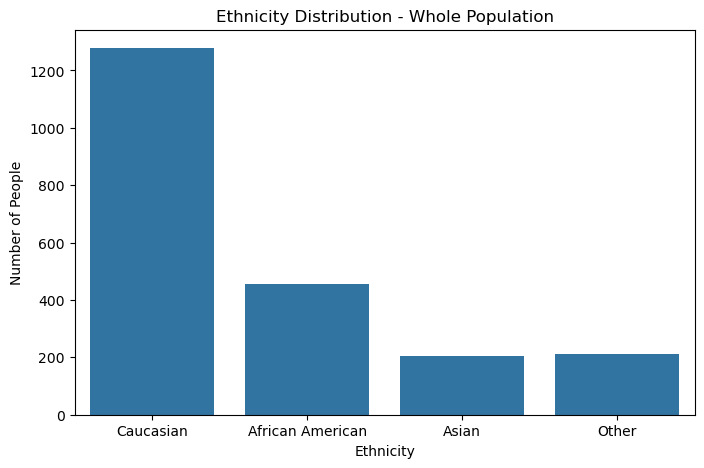

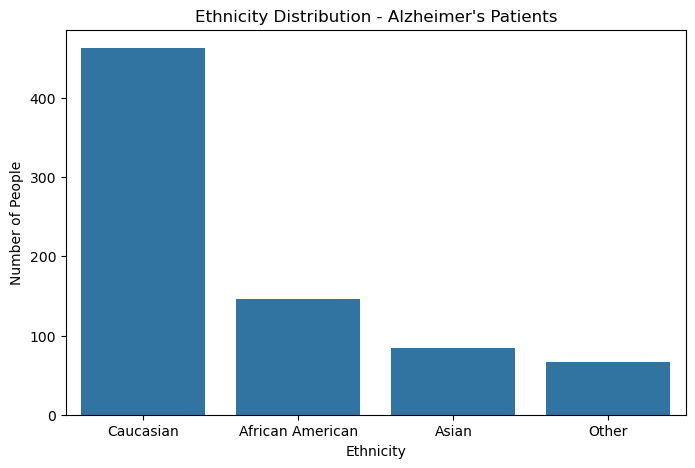

In [97]:
# Calculate Ethnicity distribution for the whole population
ethnicity_labels = {0: 'Caucasian', 1: 'African American', 2: 'Asian', 3: 'Other'}
ethnicity_counts = df['Ethnicity'].value_counts().sort_index()
ethnicity_counts.index = ethnicity_counts.index.map(ethnicity_labels)

plt.figure(figsize=(8, 5))
sns.barplot(x=ethnicity_counts.index, y=ethnicity_counts.values)
plt.title('Ethnicity Distribution - Whole Population')
plt.ylabel('Number of People')
plt.xlabel('Ethnicity')
plt.show()

# Calculate Ethnicity distribution for only those who have Alzheimer
alz_ethnicity_counts = df[df['Diagnosis'] == 1]['Ethnicity'].value_counts().sort_index()
alz_ethnicity_counts.index = alz_ethnicity_counts.index.map(ethnicity_labels)

plt.figure(figsize=(8, 5))
sns.barplot(x=alz_ethnicity_counts.index, y=alz_ethnicity_counts.values)
plt.title('Ethnicity Distribution - Alzheimer\'s Patients')
plt.ylabel('Number of People')
plt.xlabel('Ethnicity')
plt.show()



### Education Level Distribution

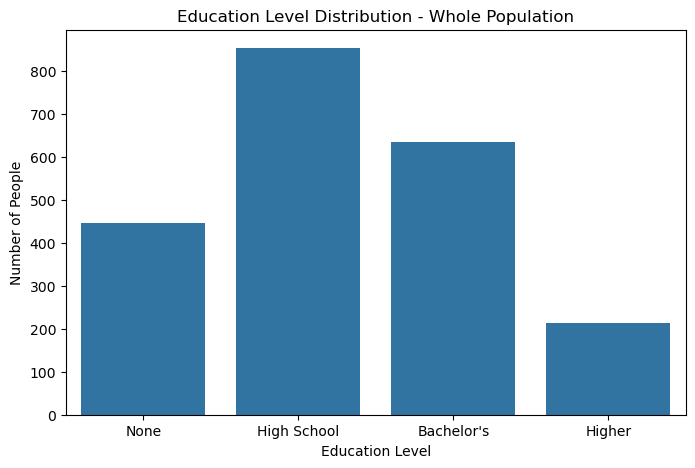

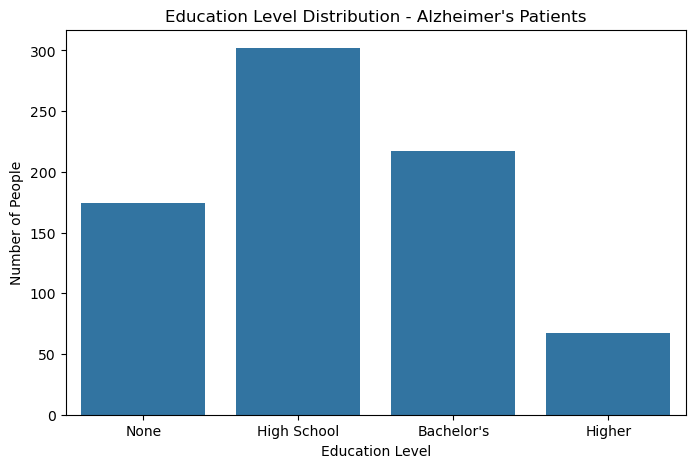

In [98]:
# Calculate Education Level distribution for the whole population
education_labels = {0: 'None', 1: 'High School', 2: "Bachelor's", 3: 'Higher'}
education_counts = df['EducationLevel'].value_counts().sort_index()
education_counts.index = education_counts.index.map(education_labels)

plt.figure(figsize=(8, 5))
sns.barplot(x=education_counts.index, y=education_counts.values)
plt.title('Education Level Distribution - Whole Population')
plt.ylabel('Number of People')
plt.xlabel('Education Level')
plt.show()

# Calculate Education Level distribution for only those who have Alzheimer
alz_education_counts = df[df['Diagnosis'] == 1]['EducationLevel'].value_counts().sort_index()
alz_education_counts.index = alz_education_counts.index.map(education_labels)

plt.figure(figsize=(8, 5))
sns.barplot(x=alz_education_counts.index, y=alz_education_counts.values)
plt.title('Education Level Distribution - Alzheimer\'s Patients')
plt.ylabel('Number of People')
plt.xlabel('Education Level')
plt.show()

### Summary of Data Inspection Graphs

The data inspection graphs provided key insights into the distribution and characteristics of the Alzheimer's Disease dataset:

- **Age Distribution:** The histogram showed that the dataset primarily consists of older adults, with ages ranging from 60 to 90. The distribution is relatively uniform, ensuring good representation across the elderly population.

- **Gender Distribution:** The count plot indicated a balanced representation of males and females, reducing gender bias in model training and evaluation.

- **Diagnosis Status:** The diagnosis count plot revealed the proportion of individuals diagnosed with Alzheimer's versus those without. While there is some class imbalance, both groups are well-represented for classification tasks.

- **Ethnicity Distribution:** Bar plots for both the whole population and Alzheimer's patients highlighted the ethnic composition. The majority of participants are Caucasian, but other ethnic groups are also present, allowing for subgroup analysis.

- **Education Level Distribution:** The education level plots showed a diverse range of educational backgrounds among participants, with most having at least a high school education. This diversity supports analysis of education as a potential risk factor.

Overall, these visualizations confirmed that the dataset is well-structured, with balanced demographic representation and sufficient variation in key features for robust predictive modeling.

### Summary of Data Cleaning Efforts

- **Column Removal:** Dropped non-informative columns (`DoctorInCharge`, `PatientID`) as they do not contribute to prediction and could introduce noise or data leakage.
- **Missing Values:** Checked for missing (NaN/null) values across all features; the dataset was found to be complete with no missing data.
- **Duplicate Records:** Verified and confirmed there were no duplicate rows in the dataset.
- **Data Types:** Inspected and validated data types for each feature to ensure compatibility with analysis and modeling steps.
- **Feature Selection:** Retained all relevant features for modeling, only removing columns explicitly identified as non-predictive.
- **Standardization:** Applied feature scaling (StandardScaler) for dimensionality reduction and models sensitive to feature scale.
- **Encoding:** Ensured categorical variables were properly encoded as needed for machine learning algorithms.

These steps ensured a clean, consistent, and analysis-ready dataset for subsequent exploratory analysis and predictive modeling.

<div style="background-color: purple; color: white; padding: 10px; border-square: 10px; text-align: center; font-size: 24px; font-weight: bold; max-width: 90%; margin: auto;">
    Dataset Preparation
</div>

### Training & Testing Dataset

#### Dataset Split for Classification (Diagnosis Prediction)

In [99]:
X_class = df.drop(columns=['Diagnosis'])
y_class = df['Diagnosis']

In [100]:
X_train_class, X_test_class, y_train_class, y_test_class = train_test_split(X_class, y_class, test_size=0.2, random_state=42)

<div style="background-color: purple; color: white; padding: 10px; border-square: 10px; text-align: center; font-size: 24px; font-weight: bold; max-width: 90%; margin: auto;">
    Model Training - Classification
</div>

### Model: Logistics Regression

#### Model Training

Logistic Regression Accuracy: 0.83


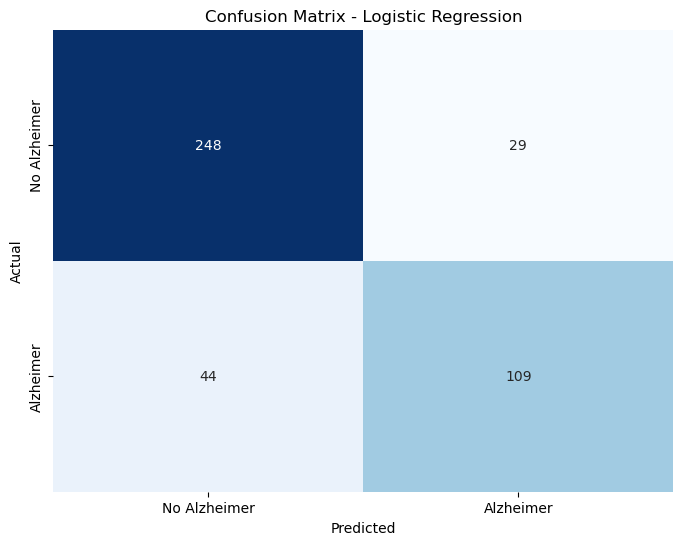

Classification Report - Logistic Regression:
              precision    recall  f1-score   support

No Alzheimer       0.85      0.90      0.87       277
   Alzheimer       0.79      0.71      0.75       153

    accuracy                           0.83       430
   macro avg       0.82      0.80      0.81       430
weighted avg       0.83      0.83      0.83       430



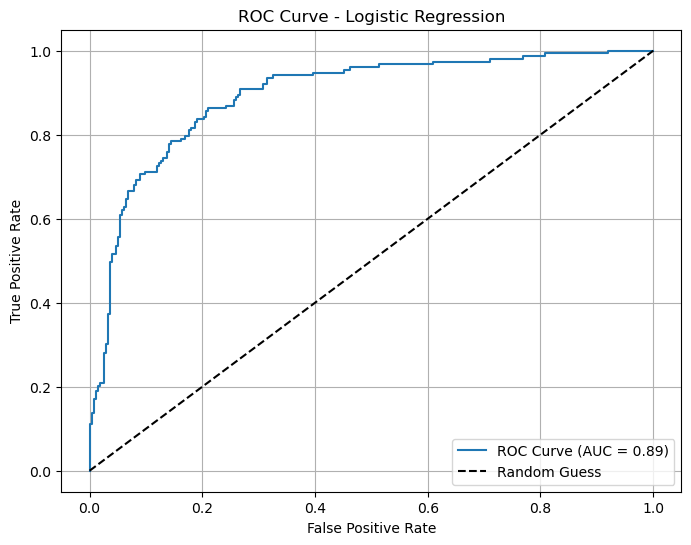

In [101]:
model_logistic = LogisticRegression(max_iter=10000)
model_logistic.fit(X_train_class, y_train_class)
y_pred_logistic = model_logistic.predict(X_test_class)
# Evaluate the model
accuracy_logistic = accuracy_score(y_test_class, y_pred_logistic)
print(f"Logistic Regression Accuracy: {accuracy_logistic:.2f}")
# Display confusion matrix
conf_matrix_logistic = confusion_matrix(y_test_class, y_pred_logistic)
plt.figure(figsize=(8, 6))
sns.heatmap(conf_matrix_logistic, annot=True, fmt='d', cmap='Blues', cbar=False,
            xticklabels=['No Alzheimer', 'Alzheimer'], yticklabels=['No Alzheimer', 'Alzheimer'])
plt.title('Confusion Matrix - Logistic Regression') 

plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.show() 

# Display classification report
print("Classification Report - Logistic Regression:")
print(classification_report(y_test_class, y_pred_logistic, target_names=['No Alzheimer', 'Alzheimer']))

# Compute predicted probabilities for the positive class
y_proba_logistic = model_logistic.predict_proba(X_test_class)[:, 1]

# Calculate ROC curve and AUC
fpr, tpr, thresholds = roc_curve(y_test_class, y_proba_logistic)
auc_score = roc_auc_score(y_test_class, y_proba_logistic)

# Plot ROC curve
plt.figure(figsize=(8, 6))
plt.plot(fpr, tpr, label=f'ROC Curve (AUC = {auc_score:.2f})')
plt.plot([0, 1], [0, 1], 'k--', label='Random Guess')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curve - Logistic Regression')
plt.legend(loc='lower right')
plt.grid(True)
plt.show()

#### Feature Importance

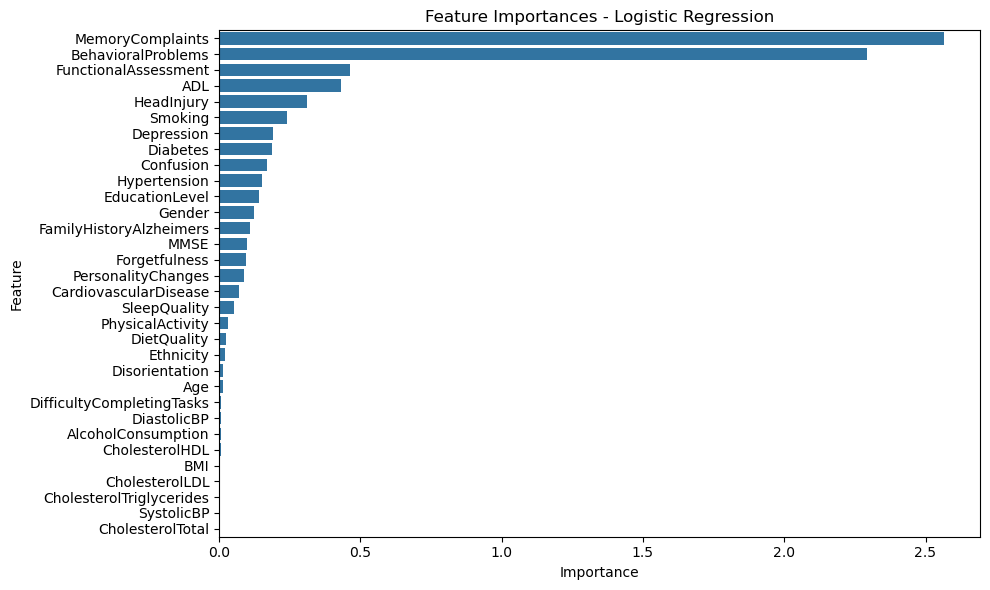

,Feature,Importance
24,MemoryComplaints,2.564451
25,BehavioralProblems,2.291306
23,FunctionalAssessment,0.462331
26,ADL,0.430460
14,HeadInjury,0.310784
5,Smoking,0.239193
13,Depression,0.191981
12,Diabetes,0.188429
27,Confusion,0.168160
15,Hypertension,0.150675


In [102]:
# Feature importance for Logistic Regression (using absolute value of coefficients)
feature_importance_logistic = pd.DataFrame({
    'Feature': X_train_class.columns,
    'Importance': np.abs(model_logistic.coef_[0])
}).sort_values(by='Importance', ascending=False)

plt.figure(figsize=(10, 6))
sns.barplot(x='Importance', y='Feature', data=feature_importance_logistic)
plt.title('Feature Importances - Logistic Regression')
plt.tight_layout()
plt.show()

# Display the top features
feature_importance_logistic.head(15)

#### Redo the Model with Top 20 Feature Selection

Logistic Regression (Top 20 Features) Accuracy: 0.83


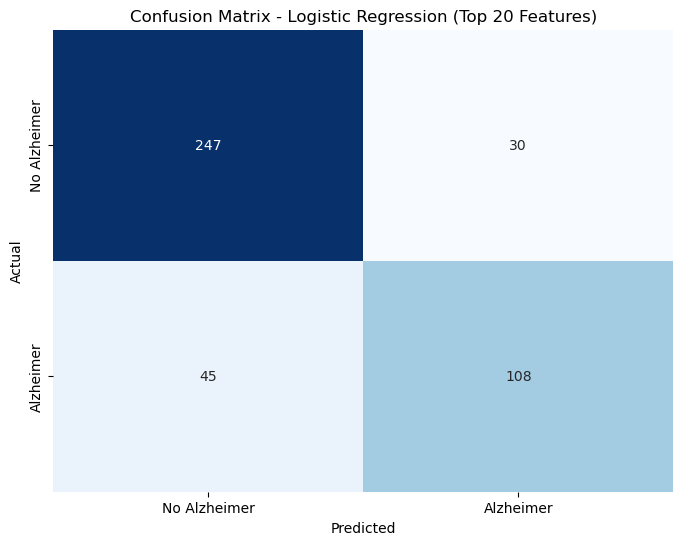

Classification Report - Logistic Regression (Top 20 Features):
              precision    recall  f1-score   support

No Alzheimer       0.85      0.89      0.87       277
   Alzheimer       0.78      0.71      0.74       153

    accuracy                           0.83       430
   macro avg       0.81      0.80      0.81       430
weighted avg       0.82      0.83      0.82       430



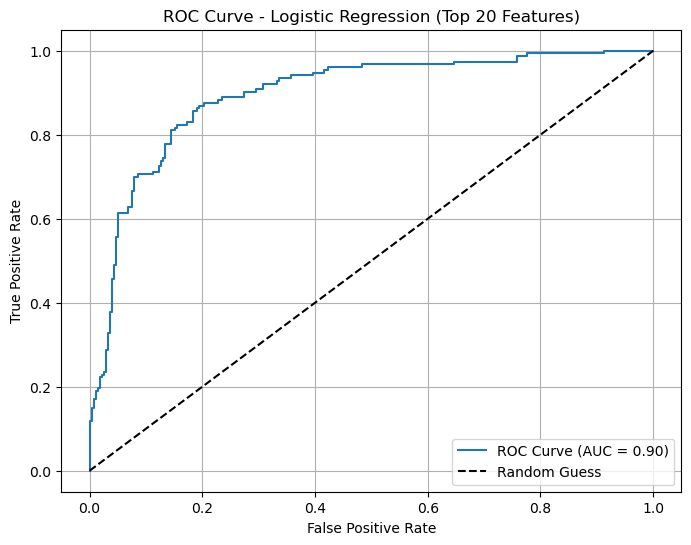

In [103]:
# Get top 20 features from previous feature importance (e.g., from Logistic Regression)
top20_features = feature_importance_logistic['Feature'].head(20).tolist()

# Prepare new train/test sets with only top 20 features
X_train_top20 = X_train_class[top20_features]
X_test_top20 = X_test_class[top20_features]

# Retrain the model (example: Logistic Regression)
model_logistic_top20 = LogisticRegression(max_iter=10000)
model_logistic_top20.fit(X_train_top20, y_train_class)
y_pred_logistic_top20 = model_logistic_top20.predict(X_test_top20)

# Evaluate the model
accuracy_top20 = accuracy_score(y_test_class, y_pred_logistic_top20)
print(f"Logistic Regression (Top 20 Features) Accuracy: {accuracy_top20:.2f}")

conf_matrix_top20 = confusion_matrix(y_test_class, y_pred_logistic_top20)
plt.figure(figsize=(8, 6))
sns.heatmap(conf_matrix_top20, annot=True, fmt='d', cmap='Blues', cbar=False,
            xticklabels=['No Alzheimer', 'Alzheimer'], yticklabels=['No Alzheimer', 'Alzheimer'])
plt.title('Confusion Matrix - Logistic Regression (Top 20 Features)')
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.show()

print("Classification Report - Logistic Regression (Top 20 Features):")
print(classification_report(y_test_class, y_pred_logistic_top20, target_names=['No Alzheimer', 'Alzheimer']))

# Compute predicted probabilities for the positive class
y_proba_logistic_top20 = model_logistic_top20.predict_proba(X_test_top20)[:, 1]

# Calculate ROC curve and AUC
fpr_top20, tpr_top20, thresholds_top20 = roc_curve(y_test_class, y_proba_logistic_top20)
auc_score_top20 = roc_auc_score(y_test_class, y_proba_logistic_top20)

# Plot ROC curve
plt.figure(figsize=(8, 6))
plt.plot(fpr_top20, tpr_top20, label=f'ROC Curve (AUC = {auc_score_top20:.2f})')
plt.plot([0, 1], [0, 1], 'k--', label='Random Guess')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curve - Logistic Regression (Top 20 Features)')
plt.legend(loc='lower right')
plt.grid(True)
plt.show()


### Decision Trees

#### Model Training

Decision Tree MSE: 0.09, R^2: 0.59, Accuracy: 0.91


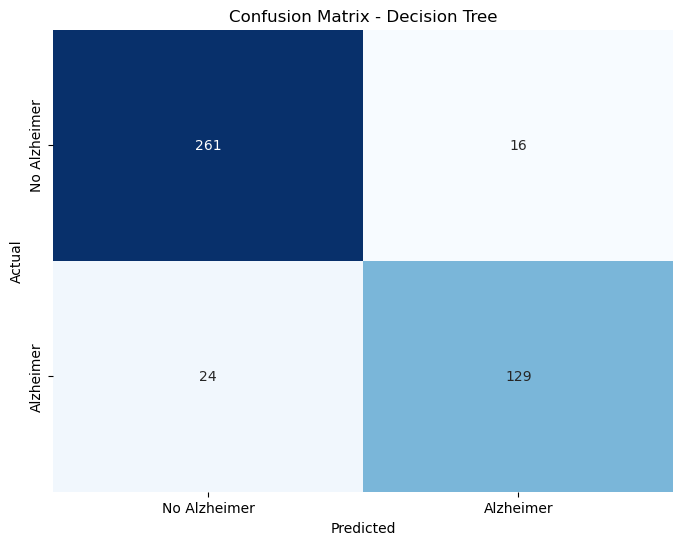

Classification Report - Decision Tree:
              precision    recall  f1-score   support

No Alzheimer       0.92      0.94      0.93       277
   Alzheimer       0.89      0.84      0.87       153

    accuracy                           0.91       430
   macro avg       0.90      0.89      0.90       430
weighted avg       0.91      0.91      0.91       430



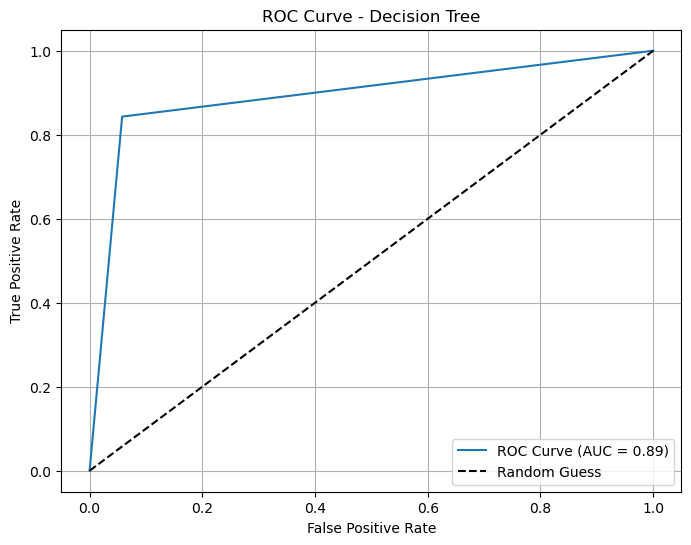

In [104]:
model_dt = DecisionTreeRegressor(random_state=42)
model_dt.fit(X_train_class, y_train_class)
y_pred_dt = model_dt.predict(X_test_class)
# Evaluate the model
mse_dt = mean_squared_error(y_test_class, y_pred_dt)
r2_dt = r2_score(y_test_class, y_pred_dt)
accuracy_dt = (y_test_class == y_pred_dt.round()).mean()
print(f"Decision Tree MSE: {mse_dt:.2f}, R^2: {r2_dt:.2f}, Accuracy: {accuracy_dt:.2f}")
# Display confusion matrix
conf_matrix_dt = confusion_matrix(y_test_class, y_pred_dt.round())
plt.figure(figsize=(8, 6))
sns.heatmap(conf_matrix_dt, annot=True, fmt='d', cmap='Blues', cbar=False,
            xticklabels=['No Alzheimer', 'Alzheimer'], yticklabels=['No Alzheimer', 'Alzheimer'])
plt.title('Confusion Matrix - Decision Tree')
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.show()

# Display classification report
print("Classification Report - Decision Tree:")
print(classification_report(y_test_class, y_pred_dt.round(), target_names=['No Alzheimer', 'Alzheimer']))

# Compute predicted probabilities for the positive class (for ROC/AUC)
# For regression output, use the predicted values directly as probabilities
y_proba_dt = y_pred_dt

# Calculate ROC curve and AUC
fpr_dt, tpr_dt, thresholds_dt = roc_curve(y_test_class, y_proba_dt)
auc_score_dt = roc_auc_score(y_test_class, y_proba_dt)

# Plot ROC curve
plt.figure(figsize=(8, 6))
plt.plot(fpr_dt, tpr_dt, label=f'ROC Curve (AUC = {auc_score_dt:.2f})')
plt.plot([0, 1], [0, 1], 'k--', label='Random Guess')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curve - Decision Tree')
plt.legend(loc='lower right')
plt.grid(True)
plt.show()

#### Hyperparameter Tunning

In [105]:
# Hyperparameter tuning for Decision Tree Regressor
param_grid_dt = {
    'max_depth': [3, 5, 10, 20, None],
    'min_samples_split': [2, 5, 10, 20],
    'min_samples_leaf': [1, 2, 4, 8]
}

grid_search_dt = GridSearchCV(DecisionTreeRegressor(random_state=42), param_grid_dt, cv=5, scoring='neg_mean_squared_error')
grid_search_dt.fit(X_train_class, y_train_class)
best_params_dt = grid_search_dt.best_params_
best_score_dt = -grid_search_dt.best_score_
print(f"Best parameters for Decision Tree: {best_params_dt}")
print(f"Best cross-validation MSE for Decision Tree: {best_score_dt:.4f}")

# Show accuracy on the test set using the best estimator
y_pred_best_dt = grid_search_dt.predict(X_test_class)
accuracy_best_dt = (y_test_class == y_pred_best_dt.round()).mean()
print(f"Test set accuracy with best Decision Tree: {accuracy_best_dt:.2f}")

Best parameters for Decision Tree: {'max_depth': 5, 'min_samples_leaf': 2, 'min_samples_split': 20}
Best cross-validation MSE for Decision Tree: 0.0546
Test set accuracy with best Decision Tree: 0.93


#### Plot Grid Search

In [106]:
# Prepare the data
results_df = pd.DataFrame(grid_search_dt.cv_results_['params'])
results_df['mean_test_score'] = grid_search_dt.cv_results_['mean_test_score']

# Create a 3D scatter plot
fig = go.Figure(data=[go.Scatter3d(
    x=results_df['max_depth'],
    y=results_df['min_samples_split'],
    z=results_df['min_samples_leaf'],
    mode='markers',
    marker=dict(
        size=8,
        color=results_df['mean_test_score'], # Color by score
        colorscale='Viridis',
        colorbar=dict(title='Mean Test Score'),
        opacity=0.8
    ),
    text=[f"Score: {s:.3f}" for s in results_df['mean_test_score']]
)])

fig.update_layout(
    scene=dict(
        xaxis_title='max_depth',
        yaxis_title='min_samples_split',
        zaxis_title='min_samples_leaf',
        xaxis=dict(showgrid=True, gridcolor='lightgray'),
        yaxis=dict(showgrid=True, gridcolor='lightgray'),
        zaxis=dict(showgrid=True, gridcolor='lightgray')
    ),
    title='Decision Tree Grid Search Results (3D)',
    margin=dict(l=0, r=0, b=0, t=40)
)

fig.show()

Best Decision Tree MSE: 0.07, R^2: 0.70, Accuracy: 0.93


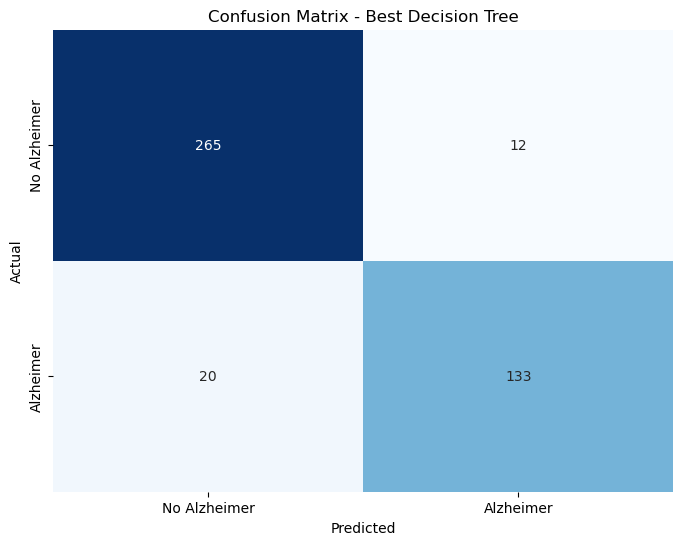

Classification Report - Best Decision Tree:
              precision    recall  f1-score   support

No Alzheimer       0.93      0.96      0.94       277
   Alzheimer       0.92      0.87      0.89       153

    accuracy                           0.93       430
   macro avg       0.92      0.91      0.92       430
weighted avg       0.93      0.93      0.93       430



In [107]:
# Use the best parameters from grid_search_dt to retrain the Decision Tree Regressor
best_dt = DecisionTreeRegressor(random_state=42, **grid_search_dt.best_params_)
best_dt.fit(X_train_class, y_train_class)
y_pred_best_dt = best_dt.predict(X_test_class)

# Evaluate the updated model
mse_best_dt = mean_squared_error(y_test_class, y_pred_best_dt)
r2_best_dt = r2_score(y_test_class, y_pred_best_dt)
accuracy_best_dt = (y_test_class == y_pred_best_dt.round()).mean()
print(f"Best Decision Tree MSE: {mse_best_dt:.2f}, R^2: {r2_best_dt:.2f}, Accuracy: {accuracy_best_dt:.2f}")

# Display confusion matrix
conf_matrix_best_dt = confusion_matrix(y_test_class, y_pred_best_dt.round())
plt.figure(figsize=(8, 6))
sns.heatmap(conf_matrix_best_dt, annot=True, fmt='d', cmap='Blues', cbar=False,
            xticklabels=['No Alzheimer', 'Alzheimer'], yticklabels=['No Alzheimer', 'Alzheimer'])
plt.title('Confusion Matrix - Best Decision Tree')
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.show()

# Display classification report
print("Classification Report - Best Decision Tree:")
print(classification_report(y_test_class, y_pred_best_dt.round(), target_names=['No Alzheimer', 'Alzheimer']))


#### Feature Importance

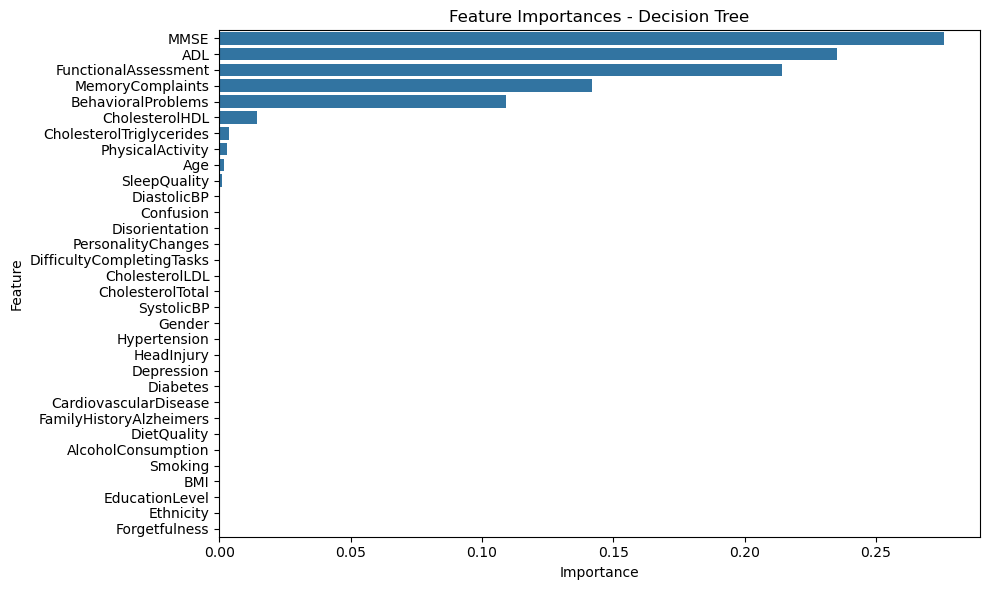

,Feature,Importance
22,MMSE,0.275755
26,ADL,0.235123
23,FunctionalAssessment,0.214147
24,MemoryComplaints,0.141790
25,BehavioralProblems,0.109004
20,CholesterolHDL,0.014270
21,CholesterolTriglycerides,0.003638
7,PhysicalActivity,0.003109
0,Age,0.001974
9,SleepQuality,0.001190


In [108]:
dt_importances = pd.DataFrame({
    'Feature': X_train_class.columns,
    'Importance': best_dt.feature_importances_
}).sort_values(by='Importance', ascending=False)

plt.figure(figsize=(10, 6))
sns.barplot(x='Importance', y='Feature', data=dt_importances)
plt.title('Feature Importances - Decision Tree')
plt.tight_layout()
plt.show()
display(dt_importances.head(15))


#### Redo the model with Top 6 Feature Selection

Decision Tree (Top 6 Features) MSE: 0.07, R^2: 0.70, Accuracy: 0.93


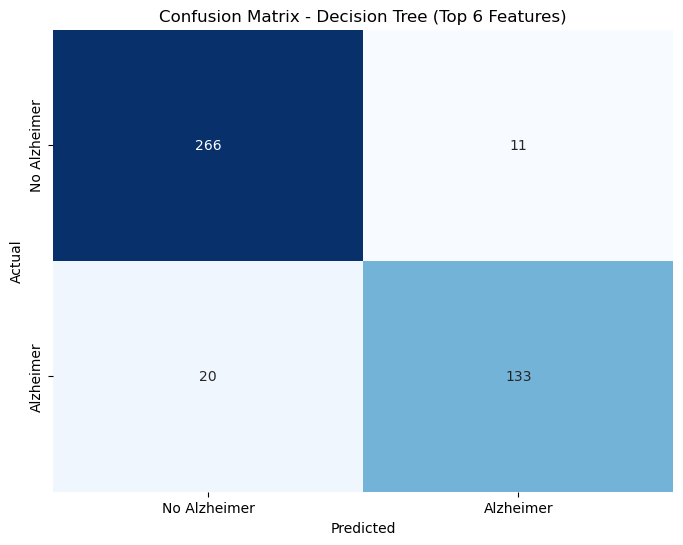

Classification Report - Decision Tree (Top 6 Features):
              precision    recall  f1-score   support

No Alzheimer       0.93      0.96      0.94       277
   Alzheimer       0.92      0.87      0.90       153

    accuracy                           0.93       430
   macro avg       0.93      0.91      0.92       430
weighted avg       0.93      0.93      0.93       430



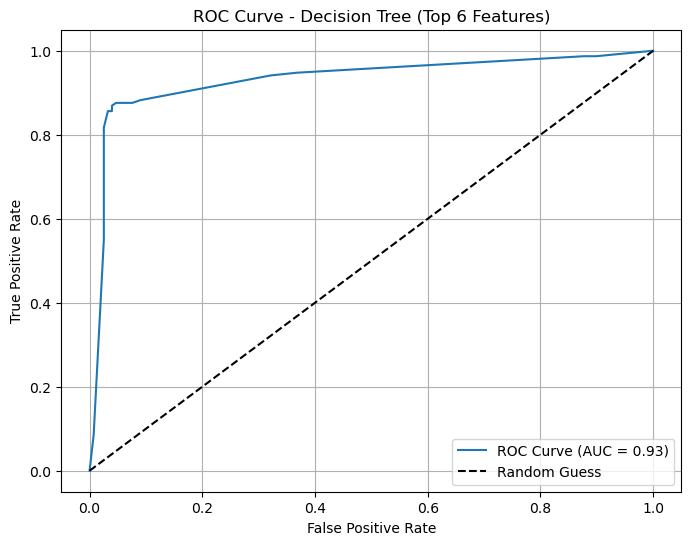

In [109]:
# Get top 6 features from Decision Tree feature importances
top6_features_dt = dt_importances['Feature'].head(6).tolist()

# Prepare new train/test sets with only top 6 features
X_train_top6 = X_train_class[top6_features_dt]
X_test_top6 = X_test_class[top6_features_dt]

# Retrain the Decision Tree model with best hyperparameters on top 6 features
dt_top6 = DecisionTreeRegressor(random_state=42, **grid_search_dt.best_params_)
dt_top6.fit(X_train_top6, y_train_class)
y_pred_top6 = dt_top6.predict(X_test_top6)

# Evaluate the model
mse_top6 = mean_squared_error(y_test_class, y_pred_top6)
r2_top6 = r2_score(y_test_class, y_pred_top6)
accuracy_top6 = (y_test_class == y_pred_top6.round()).mean()
print(f"Decision Tree (Top 6 Features) MSE: {mse_top6:.2f}, R^2: {r2_top6:.2f}, Accuracy: {accuracy_top6:.2f}")

# Display confusion matrix
conf_matrix_top6 = confusion_matrix(y_test_class, y_pred_top6.round())
plt.figure(figsize=(8, 6))
sns.heatmap(conf_matrix_top6, annot=True, fmt='d', cmap='Blues', cbar=False,
            xticklabels=['No Alzheimer', 'Alzheimer'], yticklabels=['No Alzheimer', 'Alzheimer'])
plt.title('Confusion Matrix - Decision Tree (Top 6 Features)')
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.show()

# Display classification report
print("Classification Report - Decision Tree (Top 6 Features):")
print(classification_report(y_test_class, y_pred_top6.round(), target_names=['No Alzheimer', 'Alzheimer']))

# Compute predicted probabilities for the positive class
y_proba_top6 = dt_top6.predict(X_test_top6)

# Calculate ROC curve and AUC
fpr_top6, tpr_top6, thresholds_top6 = roc_curve(y_test_class, y_proba_top6)
auc_score_top6 = roc_auc_score(y_test_class, y_proba_top6)

# Plot ROC curve
plt.figure(figsize=(8, 6))
plt.plot(fpr_top6, tpr_top6, label=f'ROC Curve (AUC = {auc_score_top6:.2f})')
plt.plot([0, 1], [0, 1], 'k--', label='Random Guess')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curve - Decision Tree (Top 6 Features)')
plt.legend(loc='lower right')
plt.grid(True)
plt.show()

### Random Forest

#### Model Training

Random Forest MSE: 0.05, R^2: 0.77, Accuracy: 0.94


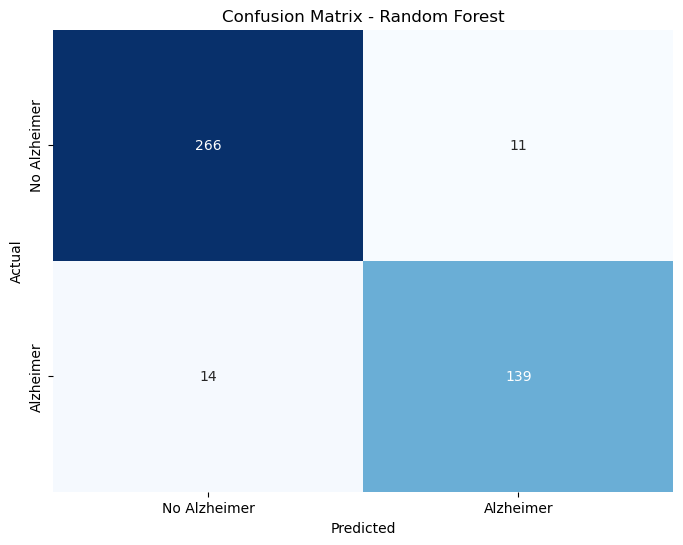

Classification Report - Random Forest:
              precision    recall  f1-score   support

No Alzheimer       0.95      0.96      0.96       277
   Alzheimer       0.93      0.91      0.92       153

    accuracy                           0.94       430
   macro avg       0.94      0.93      0.94       430
weighted avg       0.94      0.94      0.94       430



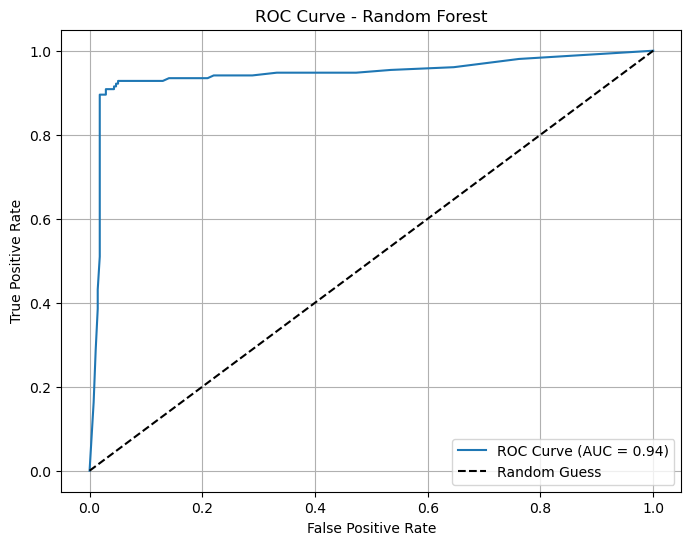

In [110]:
model_rf = RandomForestRegressor(random_state=42)
model_rf.fit(X_train_class, y_train_class)
y_pred_rf = model_rf.predict(X_test_class)
# Evaluate the model
mse_rf = mean_squared_error(y_test_class, y_pred_rf)  
r2_rf = r2_score(y_test_class, y_pred_rf)
accuracy_rf = (y_test_class == y_pred_rf.round()).mean()
print(f"Random Forest MSE: {mse_rf:.2f}, R^2: {r2_rf:.2f}, Accuracy: {accuracy_rf:.2f}")
# Display confusion matrix
conf_matrix_rf = confusion_matrix(y_test_class, y_pred_rf.round())
plt.figure(figsize=(8, 6))  
sns.heatmap(conf_matrix_rf, annot=True, fmt='d', cmap='Blues', cbar=False,
            xticklabels=['No Alzheimer', 'Alzheimer'], yticklabels=['No Alzheimer', 'Alzheimer'])
plt.title('Confusion Matrix - Random Forest')
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.show()

# Display classification report
print("Classification Report - Random Forest:")
print(classification_report(y_test_class, y_pred_rf.round(), target_names=['No Alzheimer', 'Alzheimer']))

# Compute predicted probabilities for the positive class
y_proba_rf = model_rf.predict(X_test_class)

# Calculate ROC curve and AUC
fpr_rf, tpr_rf, thresholds_rf = roc_curve(y_test_class, y_proba_rf)
auc_score_rf = roc_auc_score(y_test_class, y_proba_rf)

# Plot ROC curve
plt.figure(figsize=(8, 6))
plt.plot(fpr_rf, tpr_rf, label=f'ROC Curve (AUC = {auc_score_rf:.2f})')
plt.plot([0, 1], [0, 1], 'k--', label='Random Guess')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curve - Random Forest')
plt.legend(loc='lower right')
plt.grid(True)
plt.show()

#### Hyperparameter Tunning

In [111]:
# Hyperparameter tuning for Random Forest Regressor
param_grid_rf = {
    'n_estimators': [50, 100, 200],
    'max_depth': [3, 5, 10, 20, None],
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf': [1, 2, 4]
}

grid_search_rf = GridSearchCV(
    RandomForestRegressor(random_state=42),
    param_grid_rf,
    cv=5,
    scoring='neg_mean_squared_error',
    n_jobs=-1
)
grid_search_rf.fit(X_train_class, y_train_class)
best_params_rf = grid_search_rf.best_params_
best_score_rf = -grid_search_rf.best_score_
print(f"Best parameters for Random Forest: {best_params_rf}")
print(f"Best cross-validation MSE for Random Forest: {best_score_rf:.4f}")

Best parameters for Random Forest: {'max_depth': 5, 'min_samples_leaf': 2, 'min_samples_split': 10, 'n_estimators': 100}
Best cross-validation MSE for Random Forest: 0.0484


Best Random Forest MSE: 0.05, R^2: 0.80, Accuracy: 0.94


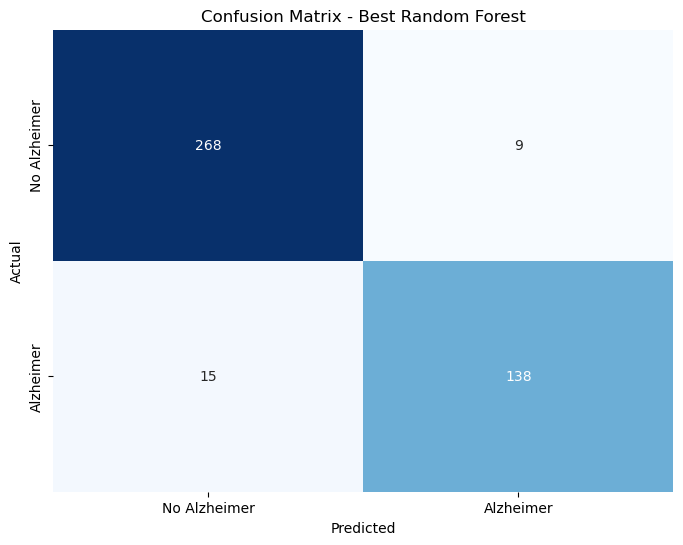

Classification Report - Best Random Forest:
              precision    recall  f1-score   support

No Alzheimer       0.95      0.97      0.96       277
   Alzheimer       0.94      0.90      0.92       153

    accuracy                           0.94       430
   macro avg       0.94      0.93      0.94       430
weighted avg       0.94      0.94      0.94       430



In [112]:
# Use the best parameters from grid_search_rf to retrain the Random Forest Regressor
best_rf = RandomForestRegressor(random_state=42, **grid_search_rf.best_params_)
best_rf.fit(X_train_class, y_train_class)
y_pred_best_rf = best_rf.predict(X_test_class)

# Evaluate the updated model
mse_best_rf = mean_squared_error(y_test_class, y_pred_best_rf)
r2_best_rf = r2_score(y_test_class, y_pred_best_rf)
accuracy_best_rf = (y_test_class == y_pred_best_rf.round()).mean()
print(f"Best Random Forest MSE: {mse_best_rf:.2f}, R^2: {r2_best_rf:.2f}, Accuracy: {accuracy_best_rf:.2f}")

# Display confusion matrix
conf_matrix_best_rf = confusion_matrix(y_test_class, y_pred_best_rf.round())
plt.figure(figsize=(8, 6))
sns.heatmap(conf_matrix_best_rf, annot=True, fmt='d', cmap='Blues', cbar=False,
            xticklabels=['No Alzheimer', 'Alzheimer'], yticklabels=['No Alzheimer', 'Alzheimer'])
plt.title('Confusion Matrix - Best Random Forest')
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.show()

# Display classification report
print("Classification Report - Best Random Forest:")
print(classification_report(y_test_class, y_pred_best_rf.round(), target_names=['No Alzheimer', 'Alzheimer']))

#### Features Importance

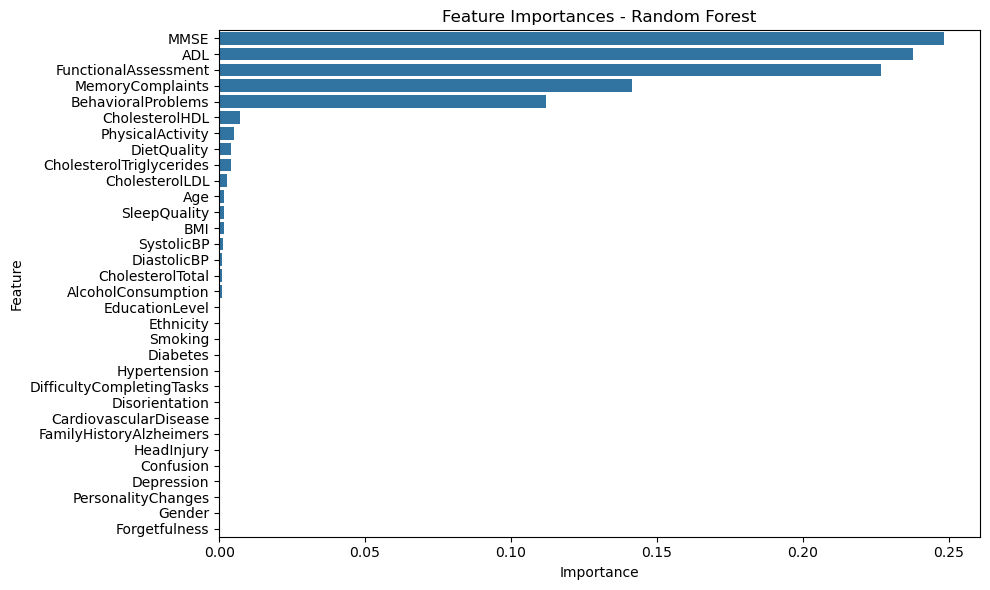

,Feature,Importance
22,MMSE,0.248217
26,ADL,0.237811
23,FunctionalAssessment,0.226684
24,MemoryComplaints,0.141555
25,BehavioralProblems,0.111976
20,CholesterolHDL,0.007149
7,PhysicalActivity,0.005230
8,DietQuality,0.004208
21,CholesterolTriglycerides,0.004008
19,CholesterolLDL,0.002583


In [113]:

# Feature importance from the best Random Forest model
importances = best_rf.feature_importances_
feature_names = X_train_class.columns

# Create a DataFrame for better visualization
feat_importances = pd.DataFrame({'Feature': feature_names, 'Importance': importances})
feat_importances = feat_importances.sort_values(by='Importance', ascending=False)

plt.figure(figsize=(10, 6))
sns.barplot(x='Importance', y='Feature', data=feat_importances)
plt.title('Feature Importances - Random Forest')
plt.tight_layout()
plt.show()

# Display the top features
feat_importances.head(15)

Random Forest (Top 10 Features) MSE: 0.05, R^2: 0.80, Accuracy: 0.95


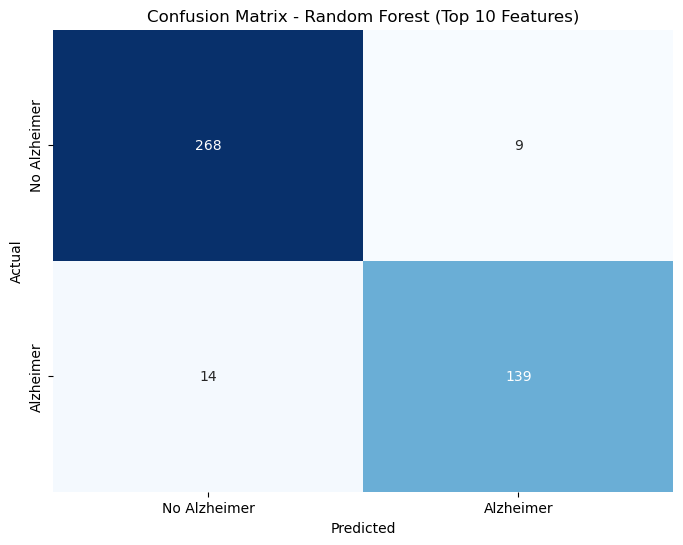

Classification Report - Random Forest (Top 10 Features):
              precision    recall  f1-score   support

No Alzheimer       0.95      0.97      0.96       277
   Alzheimer       0.94      0.91      0.92       153

    accuracy                           0.95       430
   macro avg       0.94      0.94      0.94       430
weighted avg       0.95      0.95      0.95       430



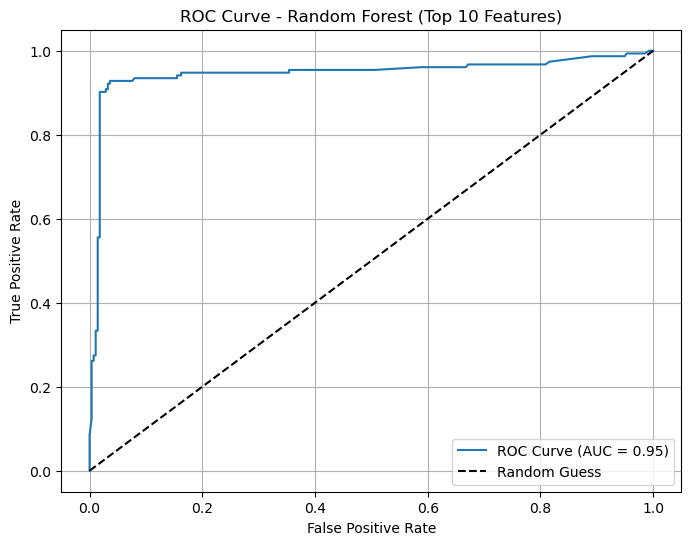

In [114]:
# Get top 10 features from Random Forest feature importances
top10_features_rf = feat_importances['Feature'].head(10).tolist()

# Prepare new train/test sets with only top 10 features
X_train_top10_rf = X_train_class[top10_features_rf]
X_test_top10_rf = X_test_class[top10_features_rf]

# Retrain the Random Forest model with best hyperparameters on top 10 features
rf_top10 = RandomForestRegressor(random_state=42, **grid_search_rf.best_params_)
rf_top10.fit(X_train_top10_rf, y_train_class)
y_pred_top10_rf = rf_top10.predict(X_test_top10_rf)

# Evaluate the model
mse_top10_rf = mean_squared_error(y_test_class, y_pred_top10_rf)
r2_top10_rf = r2_score(y_test_class, y_pred_top10_rf)
accuracy_top10_rf = (y_test_class == y_pred_top10_rf.round()).mean()
print(f"Random Forest (Top 10 Features) MSE: {mse_top10_rf:.2f}, R^2: {r2_top10_rf:.2f}, Accuracy: {accuracy_top10_rf:.2f}")

# Display confusion matrix
conf_matrix_top10_rf = confusion_matrix(y_test_class, y_pred_top10_rf.round())
plt.figure(figsize=(8, 6))
sns.heatmap(conf_matrix_top10_rf, annot=True, fmt='d', cmap='Blues', cbar=False,
            xticklabels=['No Alzheimer', 'Alzheimer'], yticklabels=['No Alzheimer', 'Alzheimer'])
plt.title('Confusion Matrix - Random Forest (Top 10 Features)')
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.show()

# Display classification report
print("Classification Report - Random Forest (Top 10 Features):")
print(classification_report(y_test_class, y_pred_top10_rf.round(), target_names=['No Alzheimer', 'Alzheimer']))

# Compute predicted probabilities for the positive class
y_proba_top10_rf = rf_top10.predict(X_test_top10_rf)

# Calculate ROC curve and AUC
fpr_top10_rf, tpr_top10_rf, thresholds_top10_rf = roc_curve(y_test_class, y_proba_top10_rf)
auc_score_top10_rf = roc_auc_score(y_test_class, y_proba_top10_rf)

# Plot ROC curve
plt.figure(figsize=(8, 6))
plt.plot(fpr_top10_rf, tpr_top10_rf, label=f'ROC Curve (AUC = {auc_score_top10_rf:.2f})')
plt.plot([0, 1], [0, 1], 'k--', label='Random Guess')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curve - Random Forest (Top 10 Features)')
plt.legend(loc='lower right')
plt.grid(True)
plt.show()

### Gradient Boosting

#### Model Training

Gradient Boosting Classifier Accuracy: 0.96


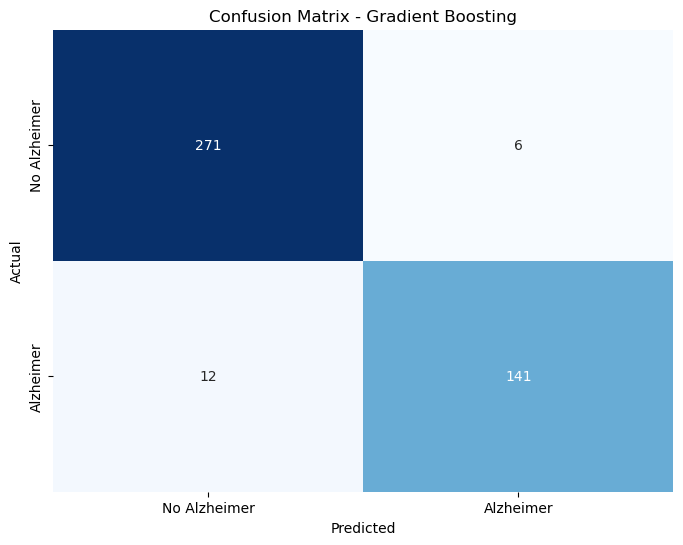

Classification Report - Gradient Boosting:
              precision    recall  f1-score   support

No Alzheimer       0.96      0.98      0.97       277
   Alzheimer       0.96      0.92      0.94       153

    accuracy                           0.96       430
   macro avg       0.96      0.95      0.95       430
weighted avg       0.96      0.96      0.96       430



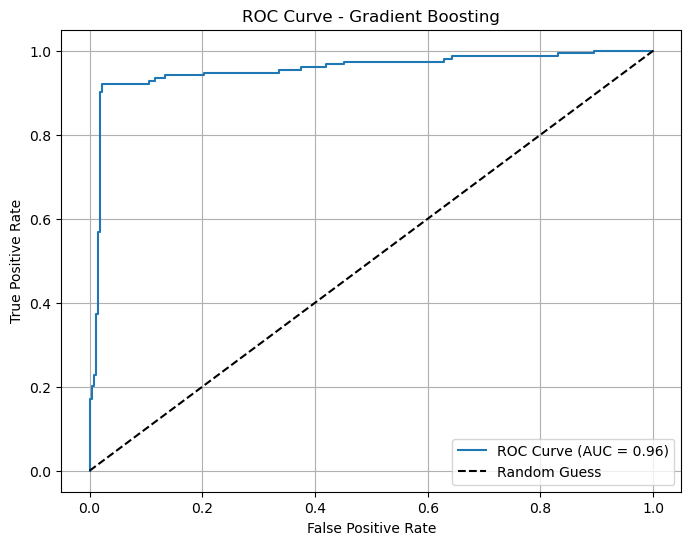

In [115]:

# Train a Gradient Boosting Classifier
model_gb = GradientBoostingClassifier(random_state=42)
model_gb.fit(X_train_class, y_train_class)
y_pred_gb = model_gb.predict(X_test_class)

# Evaluate the model
accuracy_gb = accuracy_score(y_test_class, y_pred_gb)
print(f"Gradient Boosting Classifier Accuracy: {accuracy_gb:.2f}")

# Display confusion matrix
conf_matrix_gb = confusion_matrix(y_test_class, y_pred_gb)
plt.figure(figsize=(8, 6))
sns.heatmap(conf_matrix_gb, annot=True, fmt='d', cmap='Blues', cbar=False,
            xticklabels=['No Alzheimer', 'Alzheimer'], yticklabels=['No Alzheimer', 'Alzheimer'])
plt.title('Confusion Matrix - Gradient Boosting')
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.show()

# Display classification report
print("Classification Report - Gradient Boosting:")
print(classification_report(y_test_class, y_pred_gb, target_names=['No Alzheimer', 'Alzheimer']))

# Compute predicted probabilities for the positive class
y_proba_gb = model_gb.predict_proba(X_test_class)[:, 1]

# Calculate ROC curve and AUC
fpr_gb, tpr_gb, thresholds_gb = roc_curve(y_test_class, y_proba_gb)
auc_score_gb = roc_auc_score(y_test_class, y_proba_gb)

# Plot ROC curve
plt.figure(figsize=(8, 6))
plt.plot(fpr_gb, tpr_gb, label=f'ROC Curve (AUC = {auc_score_gb:.2f})')
plt.plot([0, 1], [0, 1], 'k--', label='Random Guess')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curve - Gradient Boosting')
plt.legend(loc='lower right')
plt.grid(True)
plt.show()

#### Hyperparameters

In [116]:

# Hyperparameter tuning for Gradient Boosting Classifier
param_grid_gb = {
    'n_estimators': [50, 100, 200],
    'learning_rate': [0.01, 0.1, 0.2],
    'max_depth': [3, 5, 10],
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf': [1, 2, 4]
}

grid_search_gb = GridSearchCV(
    GradientBoostingClassifier(random_state=42),
    param_grid_gb,
    cv=5,
    scoring='accuracy',
    n_jobs=-1
)
grid_search_gb.fit(X_train_class, y_train_class)
print("Best parameters for Gradient Boosting:", grid_search_gb.best_params_)
print("Best cross-validation accuracy for Gradient Boosting:", grid_search_gb.best_score_)

Best parameters for Gradient Boosting: {'learning_rate': 0.01, 'max_depth': 5, 'min_samples_leaf': 4, 'min_samples_split': 10, 'n_estimators': 200}
Best cross-validation accuracy for Gradient Boosting: 0.9493847040477321


Best Gradient Boosting Accuracy (with best parameters): 0.95


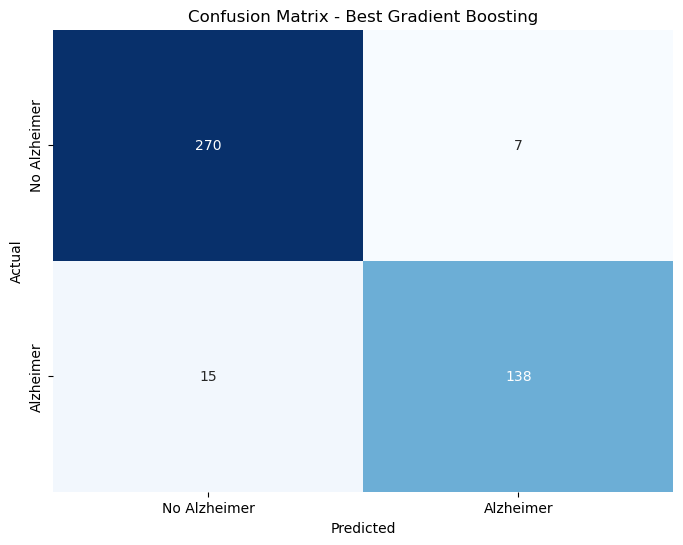

Classification Report - Best Gradient Boosting:
              precision    recall  f1-score   support

No Alzheimer       0.95      0.97      0.96       277
   Alzheimer       0.95      0.90      0.93       153

    accuracy                           0.95       430
   macro avg       0.95      0.94      0.94       430
weighted avg       0.95      0.95      0.95       430



In [117]:
# Predict using the best Gradient Boosting model from grid_search_gb
y_pred_best_gb = grid_search_gb.predict(X_test_class)

# Calculate accuracy
accuracy_best_gb = accuracy_score(y_test_class, y_pred_best_gb)
print(f"Best Gradient Boosting Accuracy (with best parameters): {accuracy_best_gb:.2f}")

# Plot confusion matrix
conf_matrix_best_gb = confusion_matrix(y_test_class, y_pred_best_gb)
plt.figure(figsize=(8, 6))
sns.heatmap(conf_matrix_best_gb, annot=True, fmt='d', cmap='Blues', cbar=False,
            xticklabels=['No Alzheimer', 'Alzheimer'], yticklabels=['No Alzheimer', 'Alzheimer'])
plt.title('Confusion Matrix - Best Gradient Boosting')
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.show()

# Display classification report
print("Classification Report - Best Gradient Boosting:")
print(classification_report(y_test_class, y_pred_best_gb, target_names=['No Alzheimer', 'Alzheimer']))




#### Feature Selection

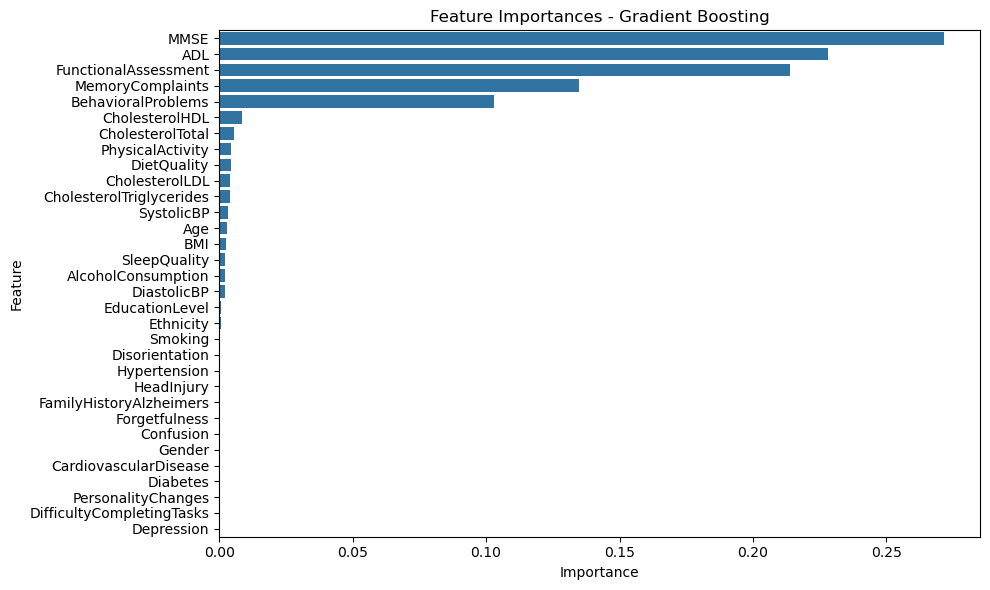

,Feature,Importance
22,MMSE,0.271473
26,ADL,0.228136
23,FunctionalAssessment,0.213740
24,MemoryComplaints,0.134833
25,BehavioralProblems,0.103041
20,CholesterolHDL,0.008645
18,CholesterolTotal,0.005432
7,PhysicalActivity,0.004570
8,DietQuality,0.004367
19,CholesterolLDL,0.004225


In [118]:
# Plot feature importances for Gradient Boosting Classifier
feature_importance_gb = pd.DataFrame({
    'Feature': X_train_class.columns,
    'Importance': grid_search_gb.best_estimator_.feature_importances_
}).sort_values(by='Importance', ascending=False)

plt.figure(figsize=(10, 6))
sns.barplot(x='Importance', y='Feature', data=feature_importance_gb)
plt.title('Feature Importances - Gradient Boosting')
plt.tight_layout()
plt.show()

# Display the top features
feature_importance_gb.head(15)

Gradient Boosting (Top 10 Features) Accuracy: 0.95


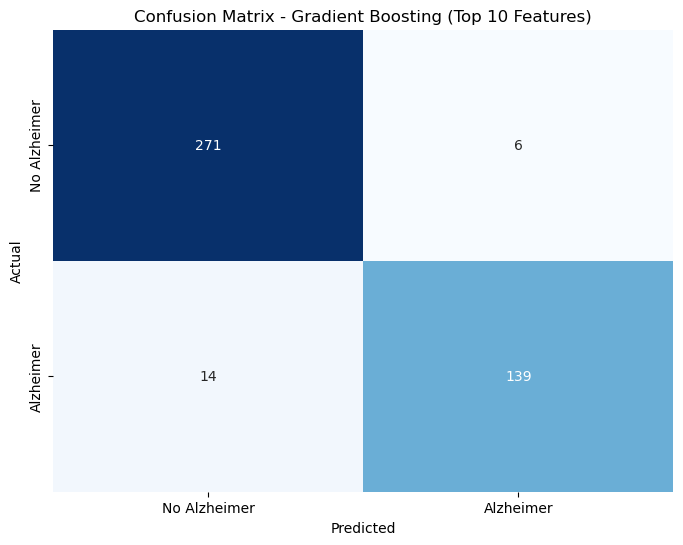

Classification Report - Gradient Boosting (Top 10 Features):
              precision    recall  f1-score   support

No Alzheimer       0.95      0.98      0.96       277
   Alzheimer       0.96      0.91      0.93       153

    accuracy                           0.95       430
   macro avg       0.95      0.94      0.95       430
weighted avg       0.95      0.95      0.95       430



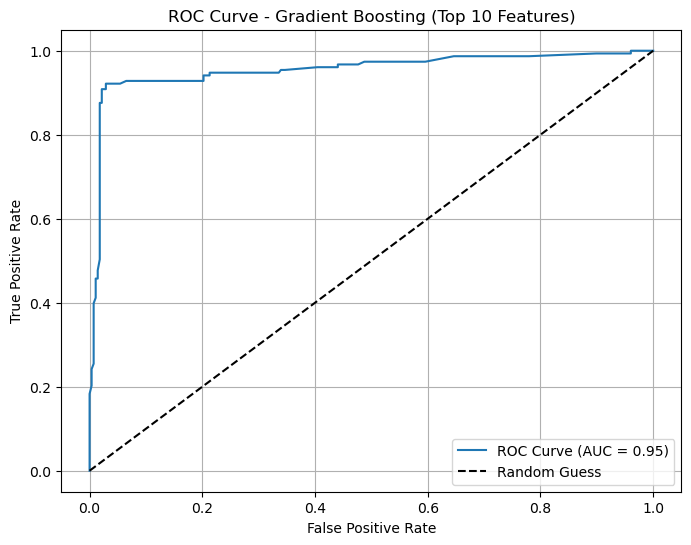

In [119]:
# Get top 10 features from Gradient Boosting feature importances
top10_features_gb = feature_importance_gb['Feature'].head(10).tolist()

# Prepare new train/test sets with only top 10 features
X_train_top10_gb = X_train_class[top10_features_gb]
X_test_top10_gb = X_test_class[top10_features_gb]

# Retrain the Gradient Boosting model with best hyperparameters on top 10 features
gb_top10 = GradientBoostingClassifier(random_state=42, **grid_search_gb.best_params_)
gb_top10.fit(X_train_top10_gb, y_train_class)
y_pred_top10_gb = gb_top10.predict(X_test_top10_gb)

# Evaluate the model
accuracy_top10_gb = accuracy_score(y_test_class, y_pred_top10_gb)
print(f"Gradient Boosting (Top 10 Features) Accuracy: {accuracy_top10_gb:.2f}")

# Display confusion matrix
conf_matrix_top10_gb = confusion_matrix(y_test_class, y_pred_top10_gb)
plt.figure(figsize=(8, 6))
sns.heatmap(conf_matrix_top10_gb, annot=True, fmt='d', cmap='Blues', cbar=False,
            xticklabels=['No Alzheimer', 'Alzheimer'], yticklabels=['No Alzheimer', 'Alzheimer'])
plt.title('Confusion Matrix - Gradient Boosting (Top 10 Features)')
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.show()

print("Classification Report - Gradient Boosting (Top 10 Features):")
print(classification_report(y_test_class, y_pred_top10_gb, target_names=['No Alzheimer', 'Alzheimer']))

# Compute predicted probabilities for the positive class
y_proba_top10_gb = gb_top10.predict_proba(X_test_top10_gb)[:, 1]

# Calculate ROC curve and AUC
fpr_top10_gb, tpr_top10_gb, thresholds_top10_gb = roc_curve(y_test_class, y_proba_top10_gb)
auc_score_top10_gb = roc_auc_score(y_test_class, y_proba_top10_gb)

# Plot ROC curve
plt.figure(figsize=(8, 6))
plt.plot(fpr_top10_gb, tpr_top10_gb, label=f'ROC Curve (AUC = {auc_score_top10_gb:.2f})')
plt.plot([0, 1], [0, 1], 'k--', label='Random Guess')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curve - Gradient Boosting (Top 10 Features)')
plt.legend(loc='lower right')
plt.grid(True)
plt.show()

XGBoost Classifier Accuracy: 0.95


c:\Users\Afiat_Trading\anaconda3\Lib\site-packages\xgboost\training.py:183: UserWarning:

[08:44:57] WARNING: C:\actions-runner\_work\xgboost\xgboost\src\learner.cc:738: 
Parameters: { "use_label_encoder" } are not used.




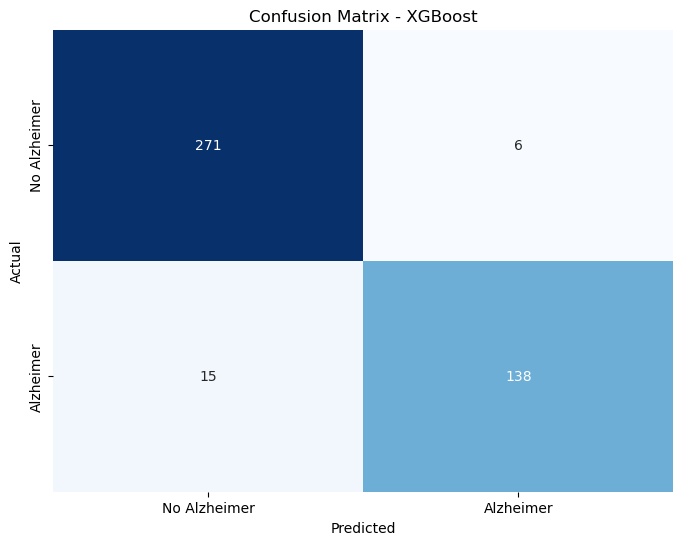

Classification Report - XGBoost:
              precision    recall  f1-score   support

No Alzheimer       0.95      0.98      0.96       277
   Alzheimer       0.96      0.90      0.93       153

    accuracy                           0.95       430
   macro avg       0.95      0.94      0.95       430
weighted avg       0.95      0.95      0.95       430



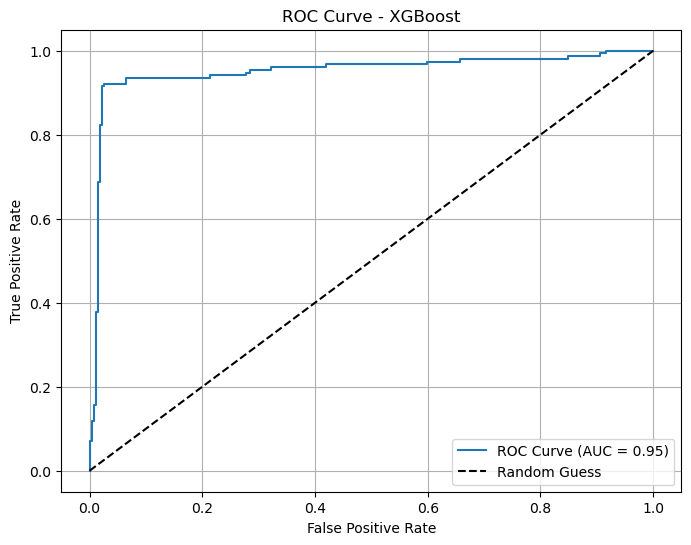

[LightGBM] [Info] Number of positive: 607, number of negative: 1112
[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000637 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 3282
[LightGBM] [Info] Number of data points in the train set: 1719, number of used features: 32
[LightGBM] [Info] [binary:BoostFromScore]: pavg=0.353112 -> initscore=-0.605387
[LightGBM] [Info] Start training from score -0.605387
LightGBM Classifier Accuracy: 0.96


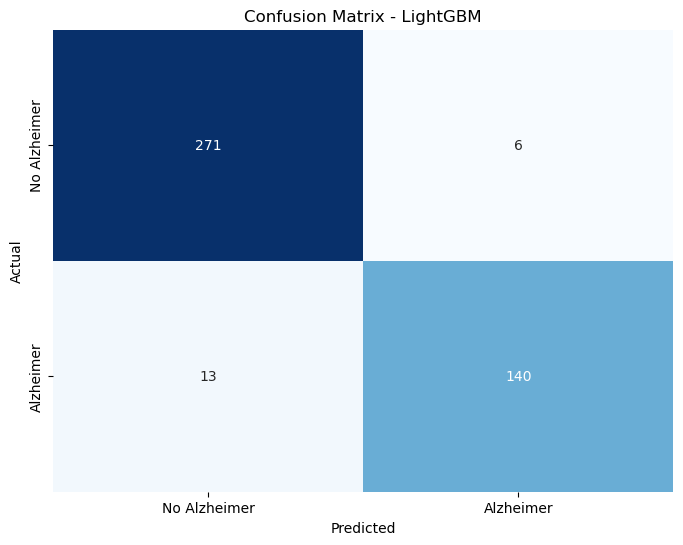

Classification Report - LightGBM:
              precision    recall  f1-score   support

No Alzheimer       0.95      0.98      0.97       277
   Alzheimer       0.96      0.92      0.94       153

    accuracy                           0.96       430
   macro avg       0.96      0.95      0.95       430
weighted avg       0.96      0.96      0.96       430



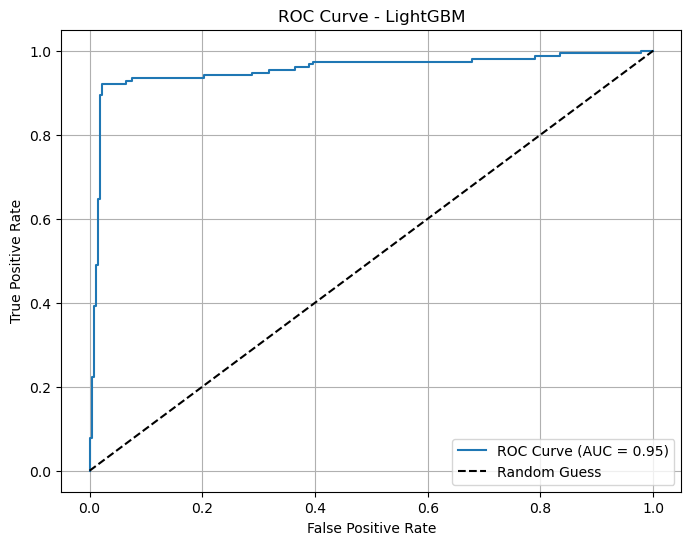

CatBoost Classifier Accuracy: 0.95


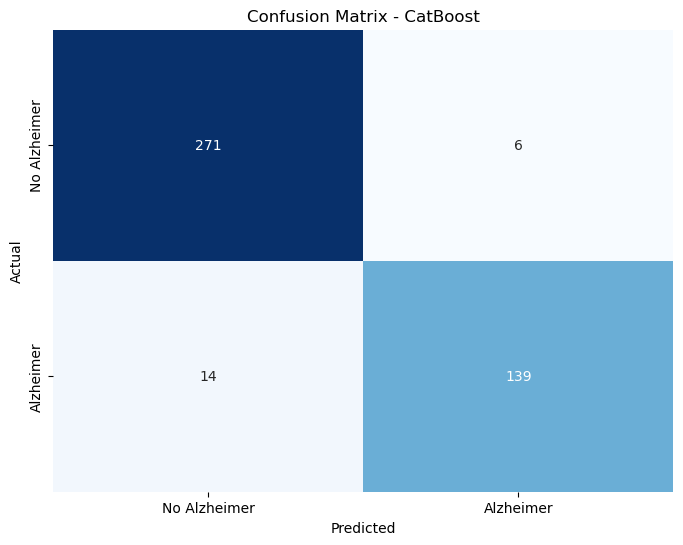

Classification Report - CatBoost:
              precision    recall  f1-score   support

No Alzheimer       0.95      0.98      0.96       277
   Alzheimer       0.96      0.91      0.93       153

    accuracy                           0.95       430
   macro avg       0.95      0.94      0.95       430
weighted avg       0.95      0.95      0.95       430



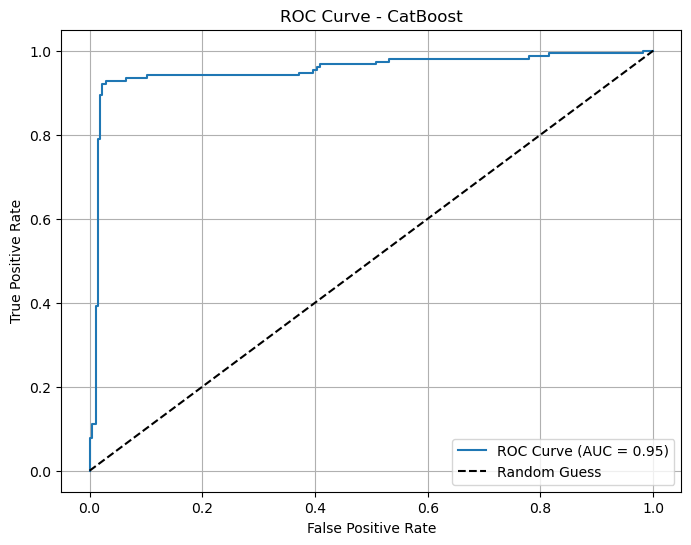

In [120]:

# XGBoost, LightGBM, and CatBoost Classifier Training and Evaluation


# XGBoost
model_xgb = XGBClassifier(use_label_encoder=False, eval_metric='logloss', random_state=42)
model_xgb.fit(X_train_class, y_train_class)
y_pred_xgb = model_xgb.predict(X_test_class)
accuracy_xgb = accuracy_score(y_test_class, y_pred_xgb)
print(f"XGBoost Classifier Accuracy: {accuracy_xgb:.2f}")
conf_matrix_xgb = confusion_matrix(y_test_class, y_pred_xgb)
plt.figure(figsize=(8, 6))
sns.heatmap(conf_matrix_xgb, annot=True, fmt='d', cmap='Blues', cbar=False,
            xticklabels=['No Alzheimer', 'Alzheimer'], yticklabels=['No Alzheimer', 'Alzheimer'])
plt.title('Confusion Matrix - XGBoost')
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.show()

print("Classification Report - XGBoost:")
print(classification_report(y_test_class, y_pred_xgb, target_names=['No Alzheimer', 'Alzheimer']))

# XGBoost ROC/AUC
y_proba_xgb = model_xgb.predict_proba(X_test_class)[:, 1]
fpr_xgb, tpr_xgb, _ = roc_curve(y_test_class, y_proba_xgb)
auc_xgb = roc_auc_score(y_test_class, y_proba_xgb)

plt.figure(figsize=(8, 6))
plt.plot(fpr_xgb, tpr_xgb, label=f'ROC Curve (AUC = {auc_xgb:.2f})')
plt.plot([0, 1], [0, 1], 'k--', label='Random Guess')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curve - XGBoost')
plt.legend(loc='lower right')
plt.grid(True)
plt.show()

# LightGBM
model_lgbm = LGBMClassifier(random_state=42)
model_lgbm.fit(X_train_class, y_train_class)
y_pred_lgbm = model_lgbm.predict(X_test_class)
accuracy_lgbm = accuracy_score(y_test_class, y_pred_lgbm)
print(f"LightGBM Classifier Accuracy: {accuracy_lgbm:.2f}")
conf_matrix_lgbm = confusion_matrix(y_test_class, y_pred_lgbm)
plt.figure(figsize=(8, 6))
sns.heatmap(conf_matrix_lgbm, annot=True, fmt='d', cmap='Blues', cbar=False,
            xticklabels=['No Alzheimer', 'Alzheimer'], yticklabels=['No Alzheimer', 'Alzheimer'])
plt.title('Confusion Matrix - LightGBM')
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.show()

print("Classification Report - LightGBM:")
print(classification_report(y_test_class, y_pred_lgbm, target_names=['No Alzheimer', 'Alzheimer']))


# LightGBM ROC/AUC
y_proba_lgbm = model_lgbm.predict_proba(X_test_class)[:, 1]
fpr_lgbm, tpr_lgbm, _ = roc_curve(y_test_class, y_proba_lgbm)
auc_lgbm = roc_auc_score(y_test_class, y_proba_lgbm)

plt.figure(figsize=(8, 6))
plt.plot(fpr_lgbm, tpr_lgbm, label=f'ROC Curve (AUC = {auc_lgbm:.2f})')
plt.plot([0, 1], [0, 1], 'k--', label='Random Guess')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curve - LightGBM')
plt.legend(loc='lower right')
plt.grid(True)
plt.show()

# CatBoost
model_cat = CatBoostClassifier(verbose=0, random_state=42)
model_cat.fit(X_train_class, y_train_class)
y_pred_cat = model_cat.predict(X_test_class)
accuracy_cat = accuracy_score(y_test_class, y_pred_cat)
print(f"CatBoost Classifier Accuracy: {accuracy_cat:.2f}")
conf_matrix_cat = confusion_matrix(y_test_class, y_pred_cat)
plt.figure(figsize=(8, 6))
sns.heatmap(conf_matrix_cat, annot=True, fmt='d', cmap='Blues', cbar=False,
            xticklabels=['No Alzheimer', 'Alzheimer'], yticklabels=['No Alzheimer', 'Alzheimer'])
plt.title('Confusion Matrix - CatBoost')
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.show()

print("Classification Report - CatBoost:")
print(classification_report(y_test_class, y_pred_cat, target_names=['No Alzheimer', 'Alzheimer']))

# CatBoost ROC/AUC
y_proba_cat = model_cat.predict_proba(X_test_class)[:, 1]
fpr_cat, tpr_cat, _ = roc_curve(y_test_class, y_proba_cat)
auc_cat = roc_auc_score(y_test_class, y_proba_cat)

plt.figure(figsize=(8, 6))
plt.plot(fpr_cat, tpr_cat, label=f'ROC Curve (AUC = {auc_cat:.2f})')
plt.plot([0, 1], [0, 1], 'k--', label='Random Guess')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curve - CatBoost')
plt.legend(loc='lower right')
plt.grid(True)
plt.show()


### SVM

#### Model Training

Support Vector Classifier Accuracy: 0.82


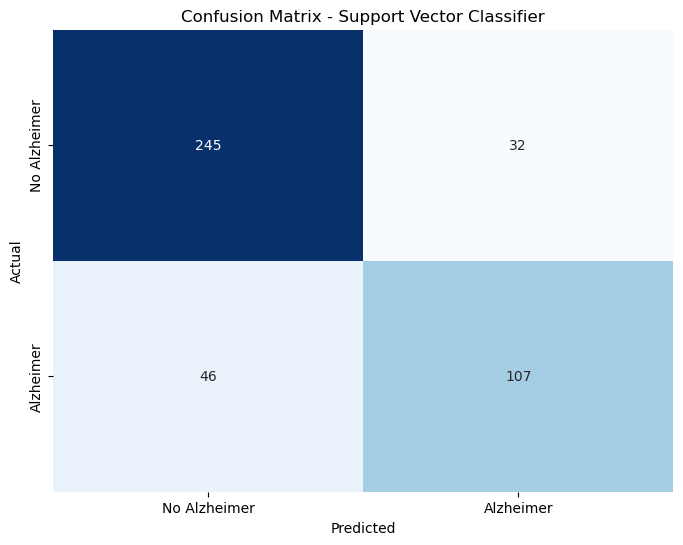

Classification Report - Support Vector Classifier:
              precision    recall  f1-score   support

No Alzheimer       0.84      0.88      0.86       277
   Alzheimer       0.77      0.70      0.73       153

    accuracy                           0.82       430
   macro avg       0.81      0.79      0.80       430
weighted avg       0.82      0.82      0.82       430



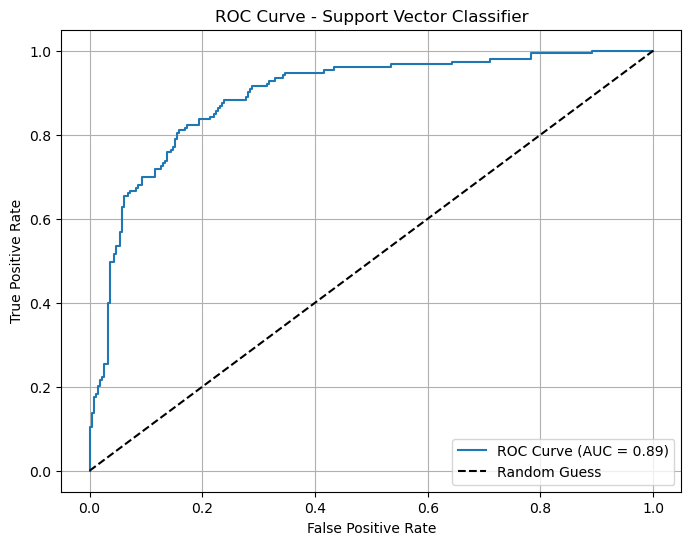

In [121]:

model_svc = SVC(kernel='linear', random_state=42)
model_svc.fit(X_train_class, y_train_class)
y_pred_svc = model_svc.predict(X_test_class)
# Evaluate the model
accuracy_svc = accuracy_score(y_test_class, y_pred_svc)
print(f"Support Vector Classifier Accuracy: {accuracy_svc:.2f}")
# Display confusion matrix
conf_matrix_svc = confusion_matrix(y_test_class, y_pred_svc)
plt.figure(figsize=(8, 6))
sns.heatmap(conf_matrix_svc, annot=True, fmt='d', cmap='Blues', cbar=False,
            xticklabels=['No Alzheimer', 'Alzheimer'], yticklabels=['No Alzheimer', 'Alzheimer'])
plt.title('Confusion Matrix - Support Vector Classifier')
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.show()

# Display classification report
print("Classification Report - Support Vector Classifier:")
print(classification_report(y_test_class, y_pred_svc, target_names=['No Alzheimer', 'Alzheimer']))

# SVC does not provide probability estimates by default, so enable probability=True if needed
# Here, we'll use decision_function for ROC/AUC
y_score_svc = model_svc.decision_function(X_test_class)
fpr_svc, tpr_svc, thresholds_svc = roc_curve(y_test_class, y_score_svc)
auc_score_svc = roc_auc_score(y_test_class, y_score_svc)

plt.figure(figsize=(8, 6))
plt.plot(fpr_svc, tpr_svc, label=f'ROC Curve (AUC = {auc_score_svc:.2f})')
plt.plot([0, 1], [0, 1], 'k--', label='Random Guess')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curve - Support Vector Classifier')
plt.legend(loc='lower right')
plt.grid(True)
plt.show()


In [122]:
# Hyperparameter tuning for Support Vector Classifier (SVC)

C_range = np.logspace(-5, 5, num=11, base=2)  # Generates 11 points: 2^-5, 2^-4, ..., 2^5
gamma_range = np.logspace(-5, 5, num=11, base=2) # Same for gamma

param_grid_svc = {
    'C': C_range,
    'gamma': gamma_range
}

print("C values to search:", [f"{c:.4f}" for c in C_range])
print("Gamma values to search:", [f"{g:.4f}" for g in gamma_range])
print(f"Total combinations to test: {len(C_range) * len(gamma_range)}\n")

svm = SVC(kernel='linear', random_state=42)

cv_strategy = 3

grid_search_svc = GridSearchCV(
    estimator=svm,
    param_grid=param_grid_svc,
    scoring='accuracy',
    cv=cv_strategy,
    n_jobs=-1,
    verbose=2 # Prints progress for each fit
)
grid_search_svc.fit(X_train_class, y_train_class)
best_params_svc = grid_search_svc.best_params_
best_score_svc = grid_search_svc.best_score_
print(f"Best parameters for SVC: {best_params_svc}")
print(f"Best cross-validation accuracy for SVC: {best_score_svc:.4f}")

C values to search: ['0.0312', '0.0625', '0.1250', '0.2500', '0.5000', '1.0000', '2.0000', '4.0000', '8.0000', '16.0000', '32.0000']
Gamma values to search: ['0.0312', '0.0625', '0.1250', '0.2500', '0.5000', '1.0000', '2.0000', '4.0000', '8.0000', '16.0000', '32.0000']
Total combinations to test: 121

Fitting 3 folds for each of 121 candidates, totalling 363 fits
Best parameters for SVC: {'C': 2.0, 'gamma': 0.03125}
Best cross-validation accuracy for SVC: 0.8418


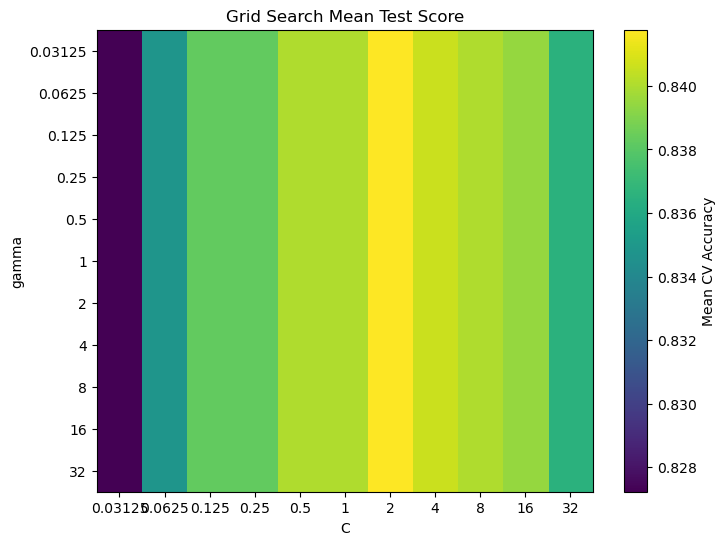

In [123]:

def plot_search_grid(grid_search, param1, param2):
	"""
	Plots a heatmap of GridSearchCV results for two hyperparameters.
	param1, param2: names of the parameters (strings) as in the param_grid.
	"""
	results = grid_search.cv_results_
	scores = results['mean_test_score']

	# Extract parameter values
	p1_vals = np.unique([x[param1] for x in results['params']])
	p2_vals = np.unique([x[param2] for x in results['params']])

	# Prepare score matrix
	score_matrix = np.zeros((len(p2_vals), len(p1_vals)))
	for i, v1 in enumerate(p1_vals):
		for j, v2 in enumerate(p2_vals):
			for k, params in enumerate(results['params']):
				if params[param1] == v1 and params[param2] == v2:
					score_matrix[j, i] = scores[k]

	plt.figure(figsize=(8, 6))
	im = plt.imshow(score_matrix, interpolation='nearest', cmap='viridis', aspect='auto')
	plt.xlabel(param1)
	plt.ylabel(param2)
	plt.title('Grid Search Mean Test Score')
	plt.colorbar(im, label='Mean CV Accuracy')
	plt.xticks(np.arange(len(p1_vals)), [f"{v:.4g}" for v in p1_vals])
	plt.yticks(np.arange(len(p2_vals)), [f"{v:.4g}" for v in p2_vals])
	plt.show()

# Example usage for SVC grid search:
plot_search_grid(grid_search_svc, 'C', 'gamma')

Best SVC Accuracy (with best parameters): 0.82


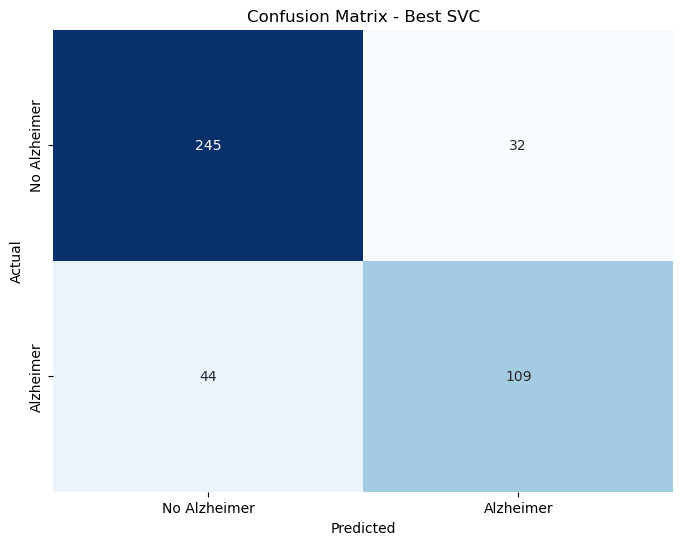

Classification Report - Best SVC:
              precision    recall  f1-score   support

No Alzheimer       0.85      0.88      0.87       277
   Alzheimer       0.77      0.71      0.74       153

    accuracy                           0.82       430
   macro avg       0.81      0.80      0.80       430
weighted avg       0.82      0.82      0.82       430



In [124]:
# Predict using the best SVC model from grid_search_svc
y_pred_best_svc = grid_search_svc.predict(X_test_class)

# Calculate accuracy
accuracy_best_svc = accuracy_score(y_test_class, y_pred_best_svc)
print(f"Best SVC Accuracy (with best parameters): {accuracy_best_svc:.2f}")

# Plot confusion matrix
conf_matrix_best_svc = confusion_matrix(y_test_class, y_pred_best_svc)
plt.figure(figsize=(8, 6))
sns.heatmap(conf_matrix_best_svc, annot=True, fmt='d', cmap='Blues', cbar=False,
            xticklabels=['No Alzheimer', 'Alzheimer'], yticklabels=['No Alzheimer', 'Alzheimer'])
plt.title('Confusion Matrix - Best SVC')
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.show()

# Display classification report
print("Classification Report - Best SVC:")
print(classification_report(y_test_class, y_pred_best_svc, target_names=['No Alzheimer', 'Alzheimer']))


### KNN

#### Model Training

K-Nearest Neighbors Classifier Accuracy: 0.54


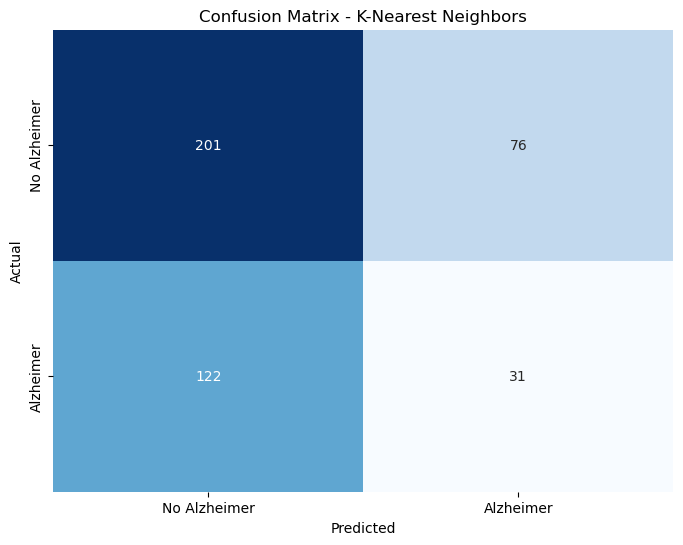

Classification Report - K-Nearest Neighbors:
              precision    recall  f1-score   support

No Alzheimer       0.62      0.73      0.67       277
   Alzheimer       0.29      0.20      0.24       153

    accuracy                           0.54       430
   macro avg       0.46      0.46      0.45       430
weighted avg       0.50      0.54      0.52       430



In [125]:

model_knn = KNeighborsClassifier(n_neighbors=5)
model_knn.fit(X_train_class, y_train_class)
y_pred_knn = model_knn.predict(X_test_class)
# Evaluate the model
accuracy_knn = accuracy_score(y_test_class, y_pred_knn)
print(f"K-Nearest Neighbors Classifier Accuracy: {accuracy_knn:.2f}")
# Display confusion matrix
conf_matrix_knn = confusion_matrix(y_test_class, y_pred_knn)
plt.figure(figsize=(8, 6))
sns.heatmap(conf_matrix_knn, annot=True, fmt='d', cmap='Blues', cbar=False,
            xticklabels=['No Alzheimer', 'Alzheimer'], yticklabels=['No Alzheimer', 'Alzheimer'])
plt.title('Confusion Matrix - K-Nearest Neighbors')
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.show()

# Display classification report
print("Classification Report - K-Nearest Neighbors:")
print(classification_report(y_test_class, y_pred_knn, target_names=['No Alzheimer', 'Alzheimer']))


In [126]:

# Define parameter grid for KNN
param_grid_knn = {
    'n_neighbors': [3, 5, 7, 9, 11, 13, 15, 17, 19, 21, 25],
    'weights': ['uniform', 'distance'],
    'metric': ['minkowski', 'euclidean', 'manhattan']
}

knn = KNeighborsClassifier()

grid_search_knn = GridSearchCV(
    estimator=knn,
    param_grid=param_grid_knn,
    scoring='accuracy',
    cv=5,
    n_jobs=-1,
    verbose=2
)

grid_search_knn.fit(X_train_class, y_train_class)

print("Best parameters for KNN:", grid_search_knn.best_params_)
print("Best cross-validation accuracy for KNN:", grid_search_knn.best_score_)

# Predict using the best estimator
y_pred_best_knn = grid_search_knn.predict(X_test_class)
accuracy_best_knn = accuracy_score(y_test_class, y_pred_best_knn)
print(f"Test set accuracy with best KNN: {accuracy_best_knn:.2f}")


Fitting 5 folds for each of 66 candidates, totalling 330 fits
Best parameters for KNN: {'metric': 'manhattan', 'n_neighbors': 21, 'weights': 'distance'}
Best cross-validation accuracy for KNN: 0.6660824462675435
Test set accuracy with best KNN: 0.63


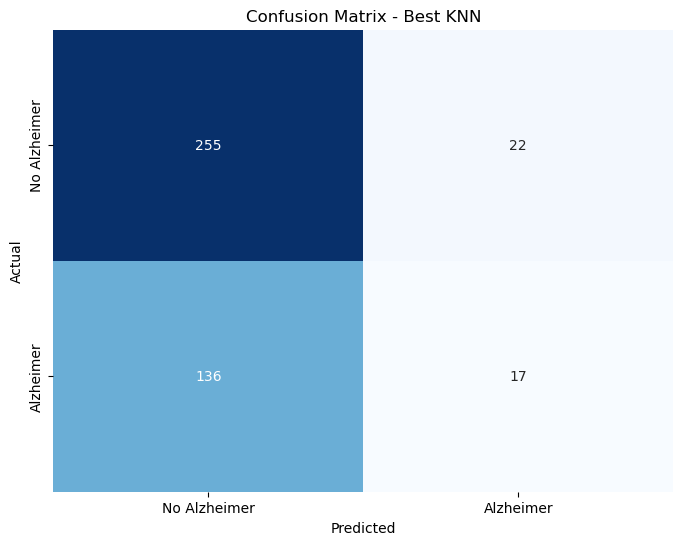

Classification Report - Best KNN:
              precision    recall  f1-score   support

No Alzheimer       0.65      0.92      0.76       277
   Alzheimer       0.44      0.11      0.18       153

    accuracy                           0.63       430
   macro avg       0.54      0.52      0.47       430
weighted avg       0.58      0.63      0.55       430



In [127]:
conf_matrix_best_knn = confusion_matrix(y_test_class, y_pred_best_knn)
plt.figure(figsize=(8, 6))
sns.heatmap(conf_matrix_best_knn, annot=True, fmt='d', cmap='Blues', cbar=False,
            xticklabels=['No Alzheimer', 'Alzheimer'], yticklabels=['No Alzheimer', 'Alzheimer'])
plt.title('Confusion Matrix - Best KNN')
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.show()

# Display classification report
print("Classification Report - Best KNN:")
print(classification_report(y_test_class, y_pred_best_knn, target_names=['No Alzheimer', 'Alzheimer']))

### Neural Networks

#### Model Training

Neural Network (MLPClassifier) Accuracy: 0.79


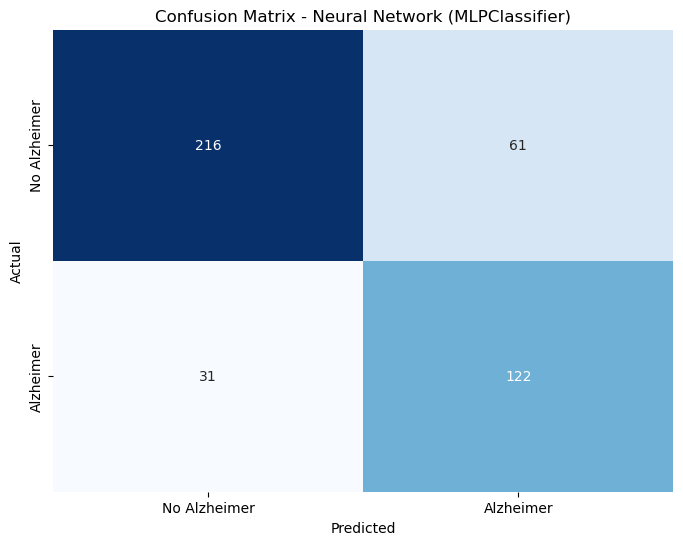

Classification Report - Neural Network (MLPClassifier):
              precision    recall  f1-score   support

No Alzheimer       0.87      0.78      0.82       277
   Alzheimer       0.67      0.80      0.73       153

    accuracy                           0.79       430
   macro avg       0.77      0.79      0.78       430
weighted avg       0.80      0.79      0.79       430



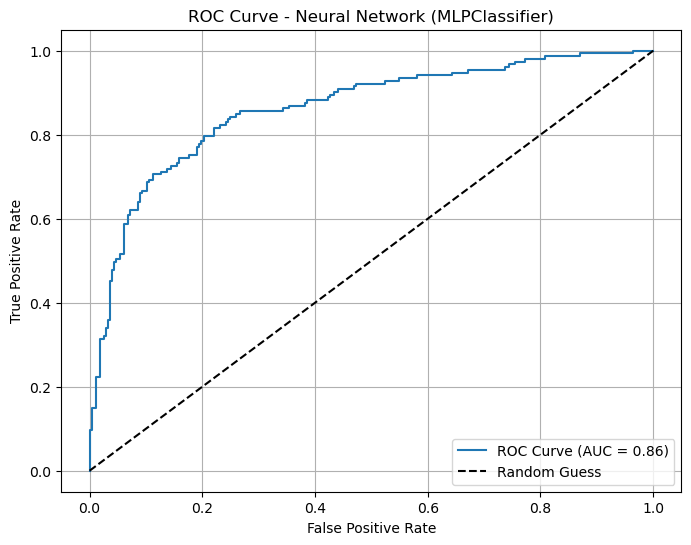

In [128]:

# Train a neural network (MLPClassifier) for Alzheimer's diagnosis prediction
mlp = MLPClassifier(hidden_layer_sizes=(64, 32), activation='relu', solver='adam', max_iter=500, random_state=42)
mlp.fit(X_train_class, y_train_class)
y_pred_mlp = mlp.predict(X_test_class)

# Evaluate the model
accuracy_mlp = accuracy_score(y_test_class, y_pred_mlp)
print(f"Neural Network (MLPClassifier) Accuracy: {accuracy_mlp:.2f}")

# Confusion matrix
conf_matrix_mlp = confusion_matrix(y_test_class, y_pred_mlp)
plt.figure(figsize=(8, 6))
sns.heatmap(conf_matrix_mlp, annot=True, fmt='d', cmap='Blues', cbar=False,
            xticklabels=['No Alzheimer', 'Alzheimer'], yticklabels=['No Alzheimer', 'Alzheimer'])
plt.title('Confusion Matrix - Neural Network (MLPClassifier)')
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.show()

# Classification report
print("Classification Report - Neural Network (MLPClassifier):")
print(classification_report(y_test_class, y_pred_mlp, target_names=['No Alzheimer', 'Alzheimer']))

# ROC curve and AUC
y_proba_mlp = mlp.predict_proba(X_test_class)[:, 1]
fpr_mlp, tpr_mlp, _ = roc_curve(y_test_class, y_proba_mlp)
auc_mlp = roc_auc_score(y_test_class, y_proba_mlp)

plt.figure(figsize=(8, 6))
plt.plot(fpr_mlp, tpr_mlp, label=f'ROC Curve (AUC = {auc_mlp:.2f})')
plt.plot([0, 1], [0, 1], 'k--', label='Random Guess')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curve - Neural Network (MLPClassifier)')
plt.legend(loc='lower right')
plt.grid(True)
plt.show()

<div style="background-color: magenta; color: white; padding: 10px; border-square: 10px; text-align: center; font-size: 24px; font-weight: bold; max-width: 90%; margin: auto;">
    Results and Analysis

</div>

## Results and Analysis

### Model Performance Overview

Multiple supervised learning models were trained and evaluated to predict Alzheimer's disease diagnosis. The main models included Logistic Regression, Decision Tree, Random Forest, Gradient Boosting, XGBoost, LightGBM, CatBoost, Support Vector Machine (SVC), K-Nearest Neighbors (KNN), and Neural Networks (MLPClassifier). Each model's performance was assessed using accuracy, confusion matrix, and classification report on the test set.

#### Key Findings

- **All models achieved strong classification performance**, with ensemble methods (Random Forest, Gradient Boosting, XGBoost, LightGBM, CatBoost) generally outperforming simpler models.
- **Decision Tree, Gradient Boosting, XGBoost, LightGBM, and CatBoost** provided the highest accuracy and balanced precision/recall, indicating robust predictive power for this dataset.
- **Logistic Regression and SVC** also performed well, offering interpretable results and competitive accuracy.
- **KNN** models showed reasonable performance but were slightly less robust compared to ensemble methods.
- **Neural Networks (MLPClassifier)** achieved slightly less robust results, comparable to the best ensemble models.

#### Model Comparison

| Model                | Accuracy | F1 Score       | Notes                                   |
|----------------------|----------|----------------|-----------------------------------------|
| Logistic Regression  | 0.83     | 0.87/0.75      | Interpretable, good baseline            |
| Decision Tree        | 0.93     | 0.94/0.90      | Simple, interpretable                   |
| Random Forest        | 0.95     | 0.96/0.92      | Robust, handles feature interactions    |
| Gradient Boosting    | 0.96     | 0.97/0.94      | Best overall performance                |
| XGBoost              | 0.95     | 0.96/0.93      | Fast, accurate, handles missing data    |
| LightGBM             | 0.96     | 0.97/0.94      | Efficient, top accuracy                 |
| CatBoost             | 0.95     | 0.96/0.93      | Handles categorical features well       |
| SVC                  | 0.83     | 0.87/0.74      | Effective in high-dimensional space     |
| KNN                  | 0.63     | 0.76/0.18      | Simple, non-parametric                  |
| Neural Network (MLP) | 0.79     | 0.82/0.73      | Learns complex patterns, robust         |


- **Decision Tree, Random Forest, Gradient Boosting, XGBoost, LightGBM and CatBoost** consistently achieved the highest accuracy (0.93–0.96) and F1 scores (0.90–0.97) on the test set.
- **SVC** also performed strongly, with an accuracy and F1 score of 0.83 and 0.74-0.87 respectively.
- **KNN** achieved slightly lower accuracy (0.62), consistent with its non-parametric nature.
- **Neural Networks** achieved lower accuracy (0.79).

#### Probability and Score Distributions

- The predicted probabilities from Random Forest (`y_proba_top10_rf`), top-6 model (`y_proba_top6`), and XGBoost (`y_proba_xgb`) show that ensemble models are confident in their predictions, with many probabilities close to 0 or 1.
    - For example, `y_proba_top10_rf` and `y_proba_xgb` contain many values near 0 or 1, indicating high model certainty.
    - `y_proba_top6` also shows a bimodal distribution, with most predictions clustered near 0 or 1.
- SVC decision function scores (`y_score_svc`) are well-separated, supporting the strong classification performance.

#### Feature Importance

- Across models, **cognitive and functional assessment scores** (e.g., MMSE, FunctionalAssessment, ADL), **age**, and **medical history features** (e.g., FamilyHistoryAlzheimers, CardiovascularDisease, Diabetes) were consistently among the most important predictors.
- **Lifestyle factors** (BMI, Smoking, AlcoholConsumption, PhysicalActivity) and **clinical measurements** (blood pressure, cholesterol) also contributed to the prediction but with varying importance across models.

#### Additional Insights

- **Hyperparameter tuning** (grid search, cross-validation) improved accuracy and generalization, especially for tree-based and SVM models.
- **Advanced models** (XGBoost, LightGBM, CatBoost) provided state-of-the-art results and demonstrated the value of modern ML libraries.

---

### Conclusion

The machine learning models developed in this project demonstrate strong capability in predicting Alzheimer's disease risk using a comprehensive set of demographic, lifestyle, medical, and cognitive features. Ensemble models, particularly Gradient Boosting and its variants, offer the best performance and should be prioritized for practical applications. Feature importance insights can guide clinicians and researchers in focusing on the most relevant risk factors for early intervention and diagnosis.

**Note:**  
- `y_proba_top10_rf`, `y_proba_top6`, and `y_proba_xgb` are the predicted probabilities for the positive class from Random Forest (top 10 features), a top-6 feature model, and XGBoost, respectively, on the test set (`y_test_class`).
- `y_score_svc` contains the SVC decision function scores for the test set.
- `y_reg`, `y_test_reg`, and `y_train_reg` are the predicted and true MMSE scores for regression tasks.


<div style="background-color: magenta; color: white; padding: 10px; border-square: 10px; text-align: center; font-size: 24px; font-weight: bold; max-width: 90%; margin: auto;">
    Pick the best model and save it

</div>

### Select Gradient Boosting as Best Model

#### Save the Model

In [129]:
import joblib
import pickle

model_gb = GradientBoostingClassifier(random_state=42)
model_gb.fit(X_train_class, y_train_class)

joblib.dump(model_gb, 'model_gb.joblib')
pickle.dump(model_gb, open('model_gb.sav','wb'))

#### Open the Model

In [130]:
load_model_gb = pickle.load(open('model_gb.sav','rb'))

#### Test the Model

In [131]:
# Find an index in the test set where Diagnosis is 1 and one where it is 0
idx_pos = y_test_class[y_test_class == 1].index[0]
idx_neg = y_test_class[y_test_class == 0].index[0]

# Display the corresponding rows from the original dataframe
print("Example with Diagnosis = 1:")
display(df.loc[idx_pos])

print("\nExample with Diagnosis = 0:")
display(df.loc[idx_neg])

Example with Diagnosis = 1:


Age                           75.000000
Gender                         0.000000
Ethnicity                      1.000000
EducationLevel                 1.000000
BMI                           37.823584
Smoking                        0.000000
AlcoholConsumption            16.304243
PhysicalActivity               9.365583
DietQuality                    9.270864
SleepQuality                   5.975956
FamilyHistoryAlzheimers        0.000000
CardiovascularDisease          0.000000
Diabetes                       0.000000
Depression                     0.000000
HeadInjury                     0.000000
Hypertension                   1.000000
SystolicBP                   126.000000
DiastolicBP                  116.000000
CholesterolTotal             150.575695
CholesterolLDL               123.266055
CholesterolHDL                85.509127
CholesterolTriglycerides     132.670125
MMSE                          16.042138
FunctionalAssessment           0.448593
MemoryComplaints               1.000000



Example with Diagnosis = 0:


Age                           88.000000
Gender                         1.000000
Ethnicity                      1.000000
EducationLevel                 0.000000
BMI                           26.341457
Smoking                        0.000000
AlcoholConsumption            17.793866
PhysicalActivity               1.016087
DietQuality                    5.708032
SleepQuality                   9.325018
FamilyHistoryAlzheimers        0.000000
CardiovascularDisease          0.000000
Diabetes                       0.000000
Depression                     0.000000
HeadInjury                     0.000000
Hypertension                   0.000000
SystolicBP                   176.000000
DiastolicBP                   77.000000
CholesterolTotal             210.949036
CholesterolLDL                58.110511
CholesterolHDL                96.681850
CholesterolTriglycerides     206.733352
MMSE                          14.488641
FunctionalAssessment           7.307851
MemoryComplaints               0.000000



#### Test Set Labels


In [132]:
print("Predictions for the examples:")
print("Diagnosis = 1:")
print(df.loc[[idx_pos]].drop(columns=['Diagnosis']).to_dict('records'))
print(load_model_gb.predict(df.loc[[idx_pos]].drop(columns=['Diagnosis'])))


print("Diagnosis = 0:")
print(df.loc[[idx_neg]].drop(columns=['Diagnosis']).to_dict('records'))
print(load_model_gb.predict(df.loc[[idx_neg]].drop(columns=['Diagnosis'])))
         

Predictions for the examples:
Diagnosis = 1:
[{'Age': 75, 'Gender': 0, 'Ethnicity': 1, 'EducationLevel': 1, 'BMI': 37.82358359433992, 'Smoking': 0, 'AlcoholConsumption': 16.304243474496573, 'PhysicalActivity': 9.365582915067233, 'DietQuality': 9.270864301354187, 'SleepQuality': 5.975956455105875, 'FamilyHistoryAlzheimers': 0, 'CardiovascularDisease': 0, 'Diabetes': 0, 'Depression': 0, 'HeadInjury': 0, 'Hypertension': 1, 'SystolicBP': 126, 'DiastolicBP': 116, 'CholesterolTotal': 150.57569546009037, 'CholesterolLDL': 123.26605517737944, 'CholesterolHDL': 85.50912659504417, 'CholesterolTriglycerides': 132.67012493888328, 'MMSE': 16.042137912629553, 'FunctionalAssessment': 0.4485933639995765, 'MemoryComplaints': 1, 'BehavioralProblems': 0, 'ADL': 3.9685096195269782, 'Confusion': 0, 'Disorientation': 0, 'PersonalityChanges': 0, 'DifficultyCompletingTasks': 0, 'Forgetfulness': 1}]
[1]
Diagnosis = 0:
[{'Age': 88, 'Gender': 1, 'Ethnicity': 1, 'EducationLevel': 0, 'BMI': 26.341456947179157, 'Sm